<a href="https://colab.research.google.com/github/Snap0dragon/Bangla-ANPR-using-Vision-Transformer/blob/main/YOLOV8_OCR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
# Install Kaggle library
!pip install -q kaggle

! mkdir ~/.kaggle


mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [4]:
! cp /content/kaggle.json ~/.kaggle/

In [5]:
! chmod 600 ~/.kaggle/kaggle.json

In [9]:
! kaggle datasets download syednahinhossain/bangladeshi-license-plate-recognition-dataset

Dataset URL: https://www.kaggle.com/datasets/syednahinhossain/bangladeshi-license-plate-recognition-dataset
License(s): apache-2.0
100% 1.70G/1.70G [00:57<00:00, 33.9MB/s]
100% 1.70G/1.70G [00:57<00:00, 31.6MB/s]


In [10]:
import zipfile
with zipfile.ZipFile('/content/bangladeshi-license-plate-recognition-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/drive/MyDrive/Colab Notebooks')

In [15]:
import os
import shutil
import xmltodict
from tqdm import tqdm

# Paths
dir = "/content/drive/MyDrive/Colab Notebooks/Character Recognition/validation/"
image_dir = os.path.join(dir, "images")
label_dir = os.path.join(dir, "labels")

# Create folders for images and labels
os.makedirs(image_dir, exist_ok=True)
os.makedirs(label_dir, exist_ok=True)

# Class Mapping
classes = [
    "0", "1", "2", "3", "4", "5", "6", "7", "8", "9",
    "ka", "kha", "ga", "gha", "ca", "ja", "ta", "da",
    "na", "ba", "va", "ha", "metro", "dhaka", "khulna",
    "chattogram", "jashore"
]

def convert_to_yolo_format(xml_file, image_filename):
    with open(xml_file, "r") as f:
        xml_content = xmltodict.parse(f.read())

    # Image dimensions
    size = xml_content["annotation"]["size"]
    img_width = int(size["width"])
    img_height = int(size["height"])

    yolo_data = []
    objects = xml_content["annotation"]["object"]
    # Handle single or multiple objects
    if not isinstance(objects, list):
        objects = [objects]

    for obj in objects:
        class_name = obj["name"]
        if class_name not in classes:
            continue  # Skip unknown classes
        class_id = classes.index(class_name)

        bndbox = obj["bndbox"]
        xmin = int(bndbox["xmin"])
        xmax = int(bndbox["xmax"])
        ymin = int(bndbox["ymin"])
        ymax = int(bndbox["ymax"])

        # Convert to YOLO format
        x_center = ((xmin + xmax) / 2) / img_width
        y_center = ((ymin + ymax) / 2) / img_height
        bbox_width = (xmax - xmin) / img_width
        bbox_height = (ymax - ymin) / img_height

        yolo_data.append(f"{class_id} {x_center:.6f} {y_center:.6f} {bbox_width:.6f} {bbox_height:.6f}")

    # Move the image to the images folder
    image_src_path = os.path.join(dir, image_filename)
    image_dst_path = os.path.join(image_dir, image_filename)
    if os.path.exists(image_src_path):
        shutil.move(image_src_path, image_dst_path)

    return yolo_data

# Process XML files
xml_files = [f for f in os.listdir(dir) if f.endswith(".xml")]
for xml_file in tqdm(xml_files, desc="Processing XML files"):
    xml_path = os.path.join(dir, xml_file)
    base_filename = os.path.splitext(xml_file)[0]
    image_filename = base_filename + ".jpg"  # Assuming image file extension is .jpg

    # Convert XML to YOLO format and save to labels folder
    yolo_data = convert_to_yolo_format(xml_path, image_filename)
    label_file = os.path.join(label_dir, base_filename + ".txt")
    with open(label_file, "w") as f:
        f.write("\n".join(yolo_data))

    # Remove the processed XML file
    os.remove(xml_path)

print("Conversion and organization completed!")



Processing XML files: 100%|██████████| 363/363 [00:08<00:00, 41.07it/s]

Conversion and organization completed!


In [16]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 905.3/905.3 kB 37.3 MB/s eta 0:00:00


In [17]:
# Create data.yaml
data_yaml = """
path: /content/drive/MyDrive/Colab Notebooks/Character Recognition
train: /content/drive/MyDrive/Colab Notebooks/Character Recognition/train/images
val: /content/drive/MyDrive/Colab Notebooks/Character Recognition/valid/images
test: /content/drive/MyDrive/Colab Notebooks/Character Recognition/test/images

names:
  0: 0
  1: 1
  2: 2
  3: 3
  4: 4
  5: 5
  6: 6
  7: 7
  8: 8
  9: 9
  10: ka
  11: kha
  12: ga
  13: gha
  14: ca
  15: ja
  16: ta
  17: da
  18: na
  19: ba
  20: va
  21: ha
  22: metro
  23: dhaka
  24: khulna
  25: chattogram
  26: jashore
"""

# Save data.yaml
with open("/content/drive/MyDrive/Colab Notebooks/Character Recognition/data.yaml", "w") as f:
    f.write(data_yaml)


In [19]:
from ultralytics import YOLO

# Load YOLOv8 model
model = YOLO("yolov8n.pt")  # Use 'yolov8n', 'yolov8s', etc., as per your resources

# Train the model
model.train(data="/content/drive/MyDrive/Colab Notebooks/Character Recognition/data.yaml", epochs=20, batch=3, imgsz=640)


Ultralytics 8.3.57 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/Colab Notebooks/Character Recognition/data.yaml, epochs=20, time=None, patience=100, batch=3, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, 

100%|██████████| 755k/755k [00:00<00:00, 41.0MB/s]


Overriding model.yaml nc=80 with nc=27

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 152MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Colab Notebooks/Character Recognition/train/labels... 3480 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3480/3480 [01:13<00:00, 47.09it/s] 


train: New cache created: /content/drive/MyDrive/Colab Notebooks/Character Recognition/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/Colab Notebooks/Character Recognition/validation/labels... 363 images, 0 backgrounds, 0 corrupt: 100%|██████████| 363/363 [00:04<00:00, 76.79it/s]


val: New cache created: /content/drive/MyDrive/Colab Notebooks/Character Recognition/validation/labels.cache
Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000323, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0004921875), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20     0.552G      1.312      2.667       1.34         60        640: 100%|██████████| 1160/1160 [02:50<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  7.73it/s]

                   all        363       3180      0.971      0.431      0.524      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20     0.505G      1.009      1.087      1.145         41        640: 100%|██████████| 1160/1160 [02:46<00:00,  6.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:05<00:00, 10.27it/s]

                   all        363       3180      0.842      0.647       0.66      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20     0.512G     0.9682     0.8698      1.108         53        640: 100%|██████████| 1160/1160 [02:45<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:05<00:00, 10.44it/s]

                   all        363       3180      0.804      0.683       0.73      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20     0.495G      0.942     0.7858      1.095         57        640: 100%|██████████| 1160/1160 [02:45<00:00,  7.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:04<00:00, 12.66it/s]

                   all        363       3180      0.899      0.705       0.79      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20     0.495G     0.9295     0.7287       1.08         43        640: 100%|██████████| 1160/1160 [02:43<00:00,  7.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:08<00:00,  6.86it/s]


                   all        363       3180      0.773      0.804      0.826      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20     0.495G     0.9158     0.6873      1.072         38        640: 100%|██████████| 1160/1160 [02:44<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  8.65it/s]

                   all        363       3180      0.828      0.822      0.844      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20     0.503G     0.9028     0.6557      1.065         64        640: 100%|██████████| 1160/1160 [02:45<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:06<00:00,  9.11it/s]


                   all        363       3180      0.851      0.827      0.842       0.63

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20     0.503G     0.8963      0.627       1.06         72        640: 100%|██████████| 1160/1160 [02:44<00:00,  7.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  7.95it/s]

                   all        363       3180      0.901      0.819      0.854      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20     0.503G     0.8828      0.604      1.053         61        640: 100%|██████████| 1160/1160 [02:46<00:00,  6.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:04<00:00, 12.59it/s]

                   all        363       3180      0.936      0.826      0.869      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20     0.497G     0.8803     0.5822      1.049         49        640: 100%|██████████| 1160/1160 [02:47<00:00,  6.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:05<00:00, 10.64it/s]


                   all        363       3180      0.877      0.865      0.889      0.679
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20     0.472G     0.8374     0.4912       1.04         27        640: 100%|██████████| 1160/1160 [02:45<00:00,  7.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  7.98it/s]

                   all        363       3180      0.918      0.847      0.902      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20     0.468G     0.8271     0.4656      1.037         27        640: 100%|██████████| 1160/1160 [02:43<00:00,  7.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:05<00:00, 10.79it/s]

                   all        363       3180      0.908      0.879      0.917      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      0.47G     0.8153     0.4486      1.026         24        640: 100%|██████████| 1160/1160 [02:43<00:00,  7.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:06<00:00,  9.89it/s]

                   all        363       3180      0.879      0.905      0.923        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20     0.474G      0.803     0.4333      1.021         23        640: 100%|██████████| 1160/1160 [02:41<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  8.67it/s]


                   all        363       3180      0.897      0.902      0.927      0.706

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      0.47G     0.7964     0.4217      1.017         27        640: 100%|██████████| 1160/1160 [02:41<00:00,  7.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  8.16it/s]


                   all        363       3180      0.923      0.888      0.944      0.718

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20     0.468G     0.7844     0.4085      1.009         27        640: 100%|██████████| 1160/1160 [02:42<00:00,  7.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:06<00:00, 10.11it/s]

                   all        363       3180      0.915      0.909      0.949      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20     0.472G     0.7762      0.399      1.007         27        640: 100%|██████████| 1160/1160 [02:45<00:00,  7.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:04<00:00, 12.50it/s]

                   all        363       3180      0.946      0.891      0.949      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20     0.472G     0.7665     0.3931      1.001         26        640: 100%|██████████| 1160/1160 [02:45<00:00,  7.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:04<00:00, 12.72it/s]

                   all        363       3180       0.91      0.921      0.948      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20     0.468G     0.7611     0.3886      0.996         27        640: 100%|██████████| 1160/1160 [02:46<00:00,  6.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:04<00:00, 12.58it/s]

                   all        363       3180       0.93      0.908      0.949      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20     0.472G     0.7546     0.3818     0.9966         26        640: 100%|██████████| 1160/1160 [02:41<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:07<00:00,  7.96it/s]


                   all        363       3180      0.931      0.911      0.949      0.725

20 epochs completed in 0.958 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.57 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,010,913 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:06<00:00,  9.28it/s]


                   all        363       3180      0.929      0.908      0.949      0.726
                     0        178        248          1      0.983      0.987      0.744
                     1        275        499      0.992      0.985      0.994      0.764
                     2        181        245      0.988      0.987      0.995      0.749
                     3        179        241      0.988      0.989      0.994       0.78
                     4        145        171       0.99      0.977      0.983       0.74
                     5        139        186      0.983          1      0.995      0.769
                     6        122        139      0.988      0.978      0.995      0.756
                     7        115        134      0.993      0.999      0.995      0.771
                     8        124        150      0.986      0.973      0.994       0.75
                     9        134        157      0.987      0.967      0.989      0.754
                    k

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x79690382dd20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.0

In [20]:
metrics = model.val()

Ultralytics 8.3.57 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,010,913 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/MyDrive/Colab Notebooks/Character Recognition/validation/labels.cache... 363 images, 0 backgrounds, 0 corrupt: 100%|██████████| 363/363 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 121/121 [00:06<00:00, 17.31it/s]


                   all        363       3180       0.93      0.909      0.949      0.728
                     0        178        248          1      0.983      0.987      0.747
                     1        275        499      0.992      0.985      0.994      0.764
                     2        181        245      0.988      0.987      0.995       0.75
                     3        179        241      0.988      0.989      0.994      0.777
                     4        145        171      0.989      0.977      0.983      0.741
                     5        139        186      0.983          1      0.995      0.768
                     6        122        139      0.988      0.978      0.995      0.752
                     7        115        134      0.993      0.999      0.995      0.774
                     8        124        150      0.986      0.971      0.994      0.754
                     9        134        157      0.987      0.968      0.989      0.751
                    k

In [21]:
results = model.predict(source="/content/drive/MyDrive/Colab Notebooks/Character Recognition/test/images/110_78_1_jpg.rf.d7fe68d3205b26fe2a8f82ec749245d3.jpg", save=True)


image 1/1 /content/drive/MyDrive/Colab Notebooks/Character Recognition/test/images/110_78_1_jpg.rf.d7fe68d3205b26fe2a8f82ec749245d3.jpg: 320x640 1 1, 1 2, 1 5, 1 6, 1 7, 1 8, 1 gha, 1 metro, 1 dhaka, 53.4ms
Speed: 3.0ms preprocess, 53.4ms inference, 2.0ms postprocess per image at shape (1, 3, 320, 640)
Results saved to runs/detect/train23



0: 352x640 1 1, 1 2, 1 4, 1 5, 1 7, 1 9, 1 ga, 1 metro, 1 dhaka, 112.4ms
Speed: 3.8ms preprocess, 112.4ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)


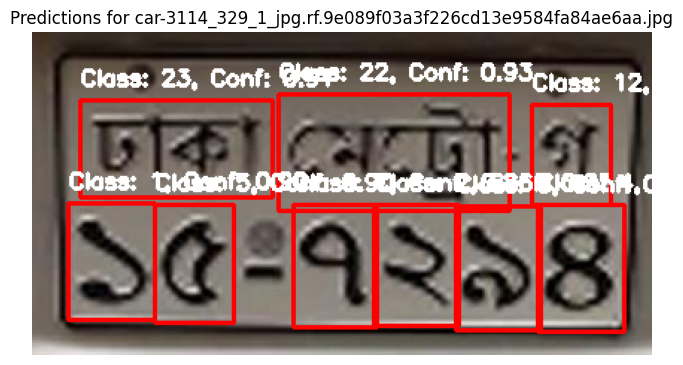


0: 352x640 1 0, 2 1s, 1 3, 2 7s, 1 ga, 1 metro, 1 dhaka, 139.4ms
Speed: 3.2ms preprocess, 139.4ms inference, 0.9ms postprocess per image at shape (1, 3, 352, 640)


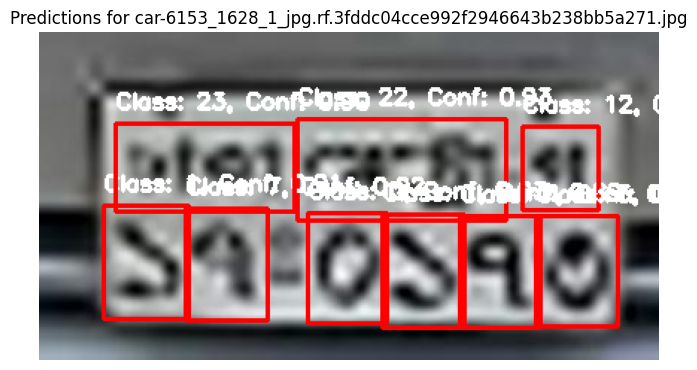


0: 352x640 1 0, 2 1s, 1 3, 1 4, 1 7, 1 kha, 1 metro, 1 dhaka, 250.3ms
Speed: 4.9ms preprocess, 250.3ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


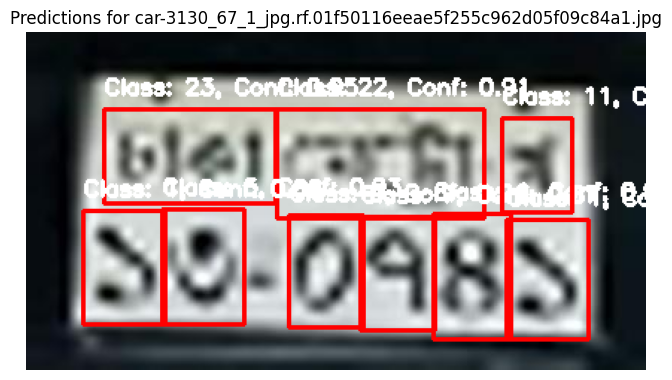


0: 352x640 1 0, 1 1, 1 2, 1 5, 1 6, 1 9, 1 ta, 1 metro, 1 dhaka, 162.9ms
Speed: 3.0ms preprocess, 162.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


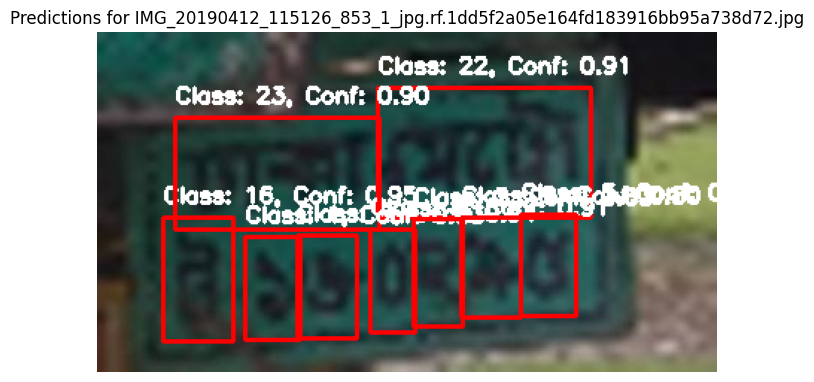


0: 320x640 4 1s, 1 8, 1 9, 1 va, 1 metro, 1 dhaka, 211.8ms
Speed: 2.6ms preprocess, 211.8ms inference, 3.9ms postprocess per image at shape (1, 3, 320, 640)


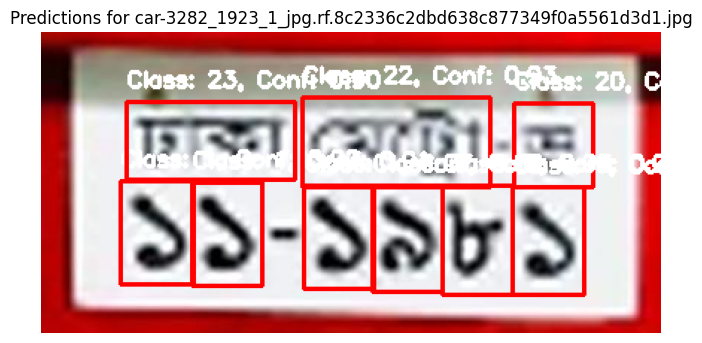


0: 352x640 1 1, 1 3, 3 5s, 1 9, 1 ga, 1 metro, 1 dhaka, 195.8ms
Speed: 2.8ms preprocess, 195.8ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)


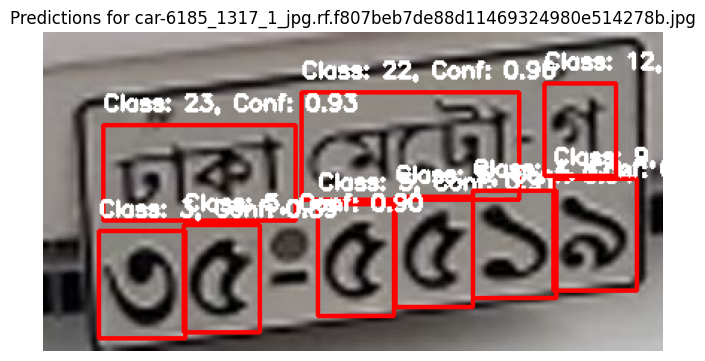


0: 320x640 1 0, 2 1s, 2 2s, 1 3, 1 ga, 1 metro, 1 dhaka, 196.8ms
Speed: 2.5ms preprocess, 196.8ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


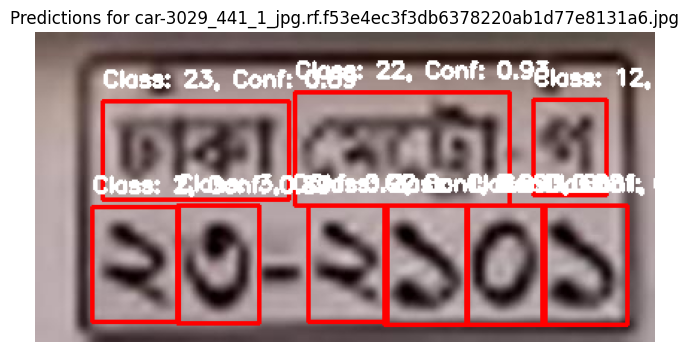


0: 448x640 3 3s, 2 5s, 1 9, 1 ga, 1 metro, 1 dhaka, 239.1ms
Speed: 3.4ms preprocess, 239.1ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


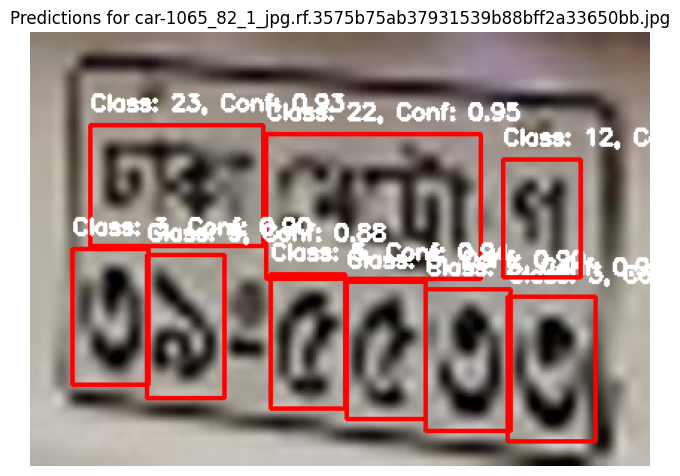


0: 640x640 2 0s, 2 1s, 1 7, 1 9, 1 ta, 1 metro, 1 khulna, 375.8ms
Speed: 8.7ms preprocess, 375.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


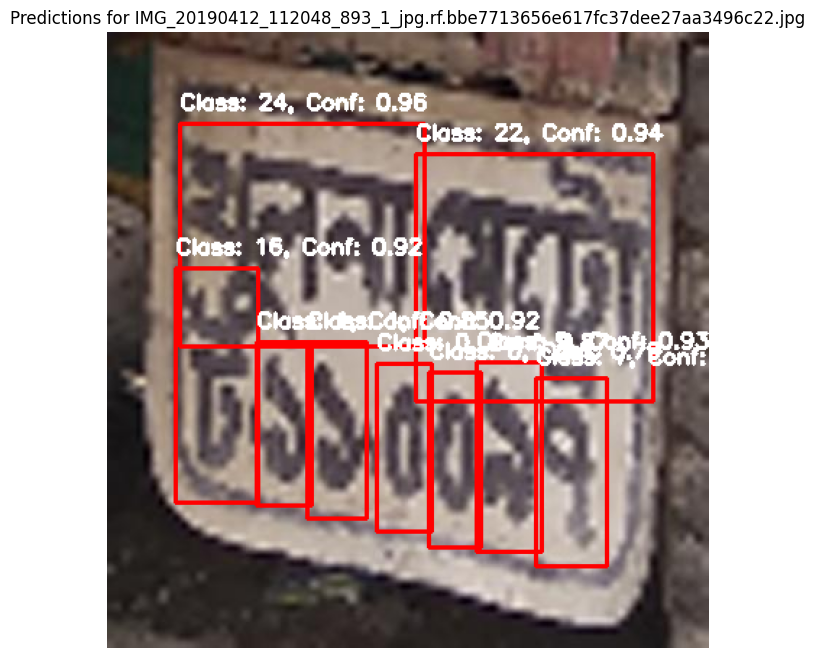


0: 288x640 2 1s, 1 3, 2 5s, 1 9, 1 ca, 1 metro, 1 dhaka, 160.4ms
Speed: 3.2ms preprocess, 160.4ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


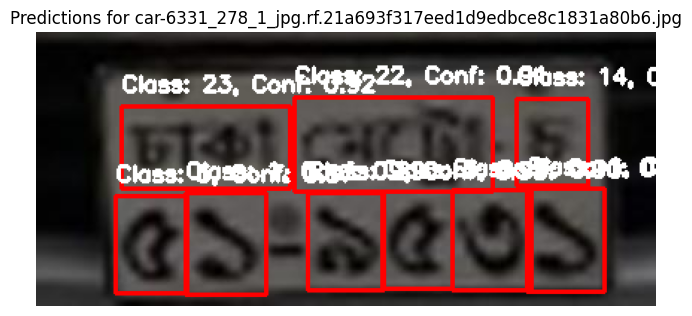


0: 480x640 2 0s, 3 1s, 1 3, 1 ba, 1 metro, 1 khulna, 257.1ms
Speed: 10.4ms preprocess, 257.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


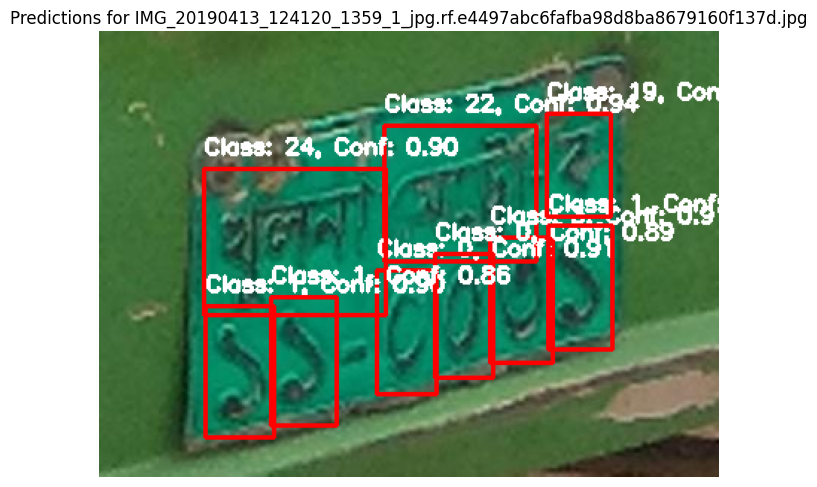


0: 512x640 1 0, 2 2s, 1 3, 1 6, 1 8, 1 ga, 1 metro, 1 dhaka, 291.3ms
Speed: 5.7ms preprocess, 291.3ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)


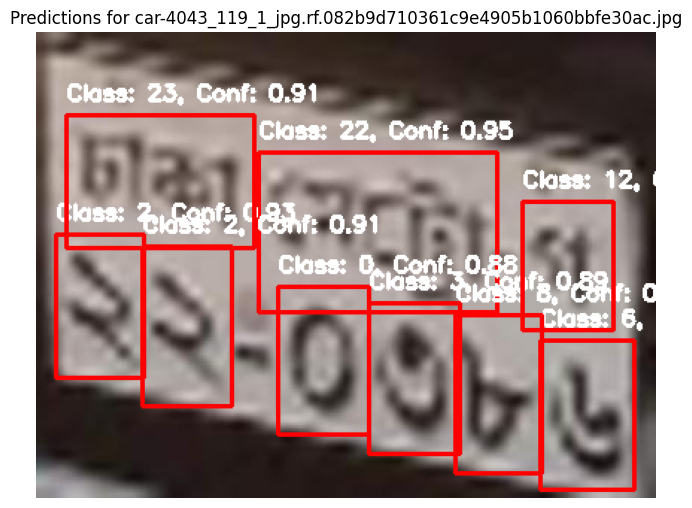


0: 320x640 1 2, 3 6s, 1 7, 1 9, 1 ga, 1 metro, 1 dhaka, 191.4ms
Speed: 3.4ms preprocess, 191.4ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)


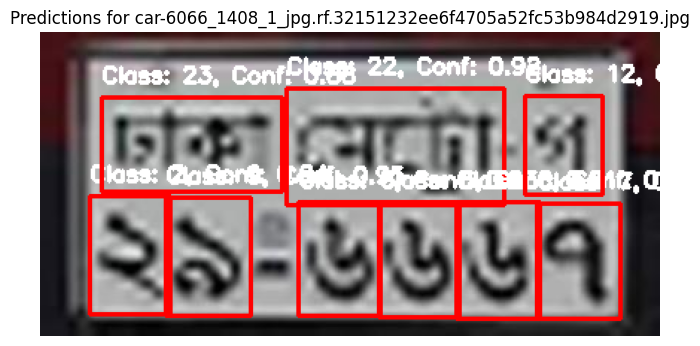


0: 352x640 1 0, 1 1, 1 3, 3 9s, 1 gha, 1 metro, 1 dhaka, 247.1ms
Speed: 2.7ms preprocess, 247.1ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


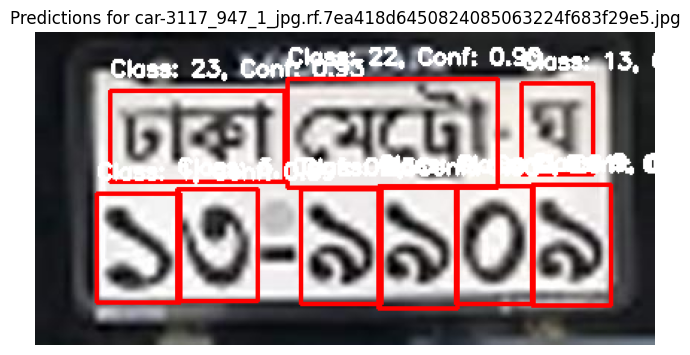


0: 384x640 3 1s, 1 8, 2 9s, 1 kha, 1 metro, 1 dhaka, 163.1ms
Speed: 2.9ms preprocess, 163.1ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


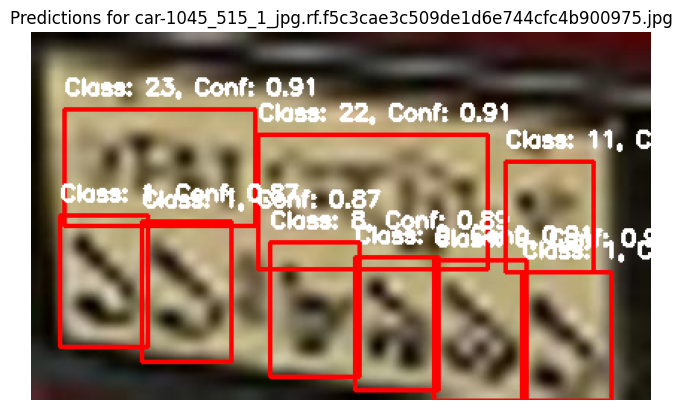


0: 384x640 1 0, 1 1, 2 2s, 1 5, 1 7, 1 kha, 1 metro, 1 dhaka, 184.0ms
Speed: 3.0ms preprocess, 184.0ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


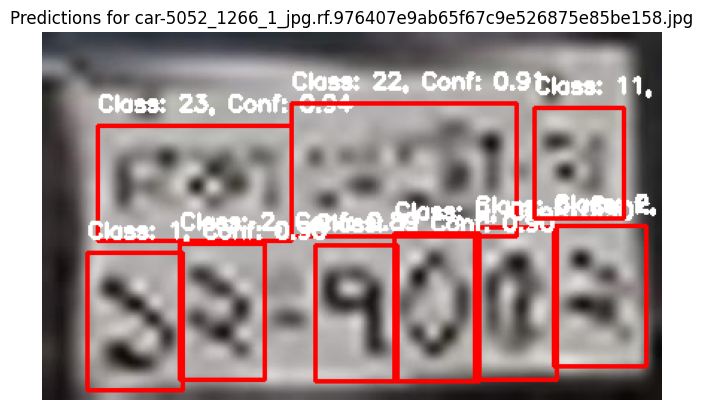


0: 352x640 1 0, 4 1s, 1 9, 1 ja, 1 metro, 1 dhaka, 168.6ms
Speed: 3.6ms preprocess, 168.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


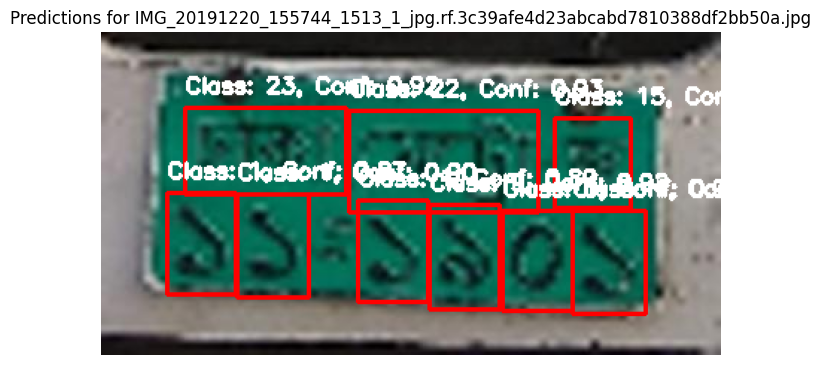


0: 416x640 1 1, 1 5, 1 6, 1 7, 1 8, 1 9, 1 ga, 1 metro, 1 dhaka, 192.6ms
Speed: 3.7ms preprocess, 192.6ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


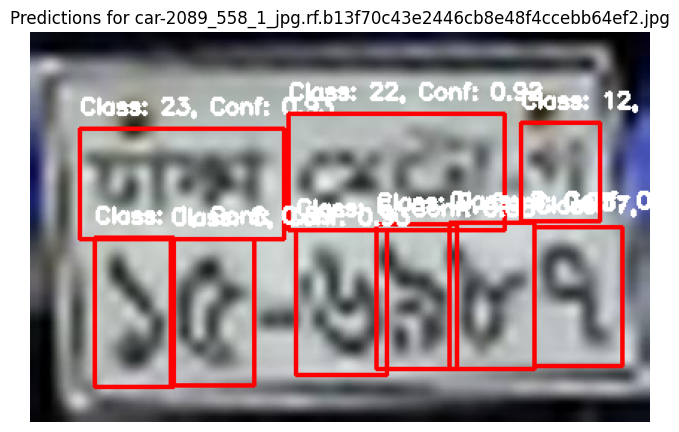


0: 320x640 1 1, 1 2, 1 4, 4 8s, 2 bas, 1 metro, 1 dhaka, 168.3ms
Speed: 2.6ms preprocess, 168.3ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)


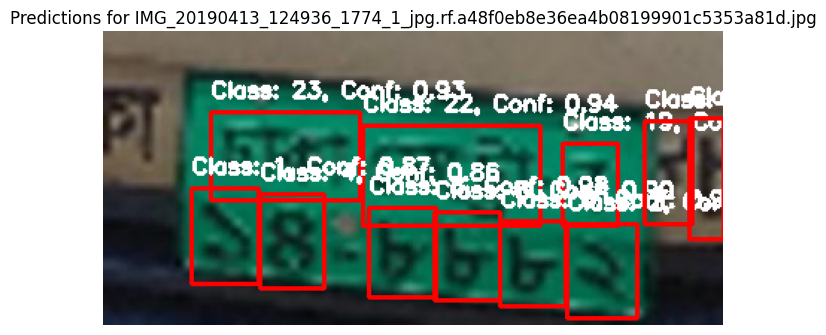


0: 320x640 1 0, 1 1, 1 2, 1 3, 2 8s, 1 ga, 1 metro, 1 dhaka, 160.3ms
Speed: 2.4ms preprocess, 160.3ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)


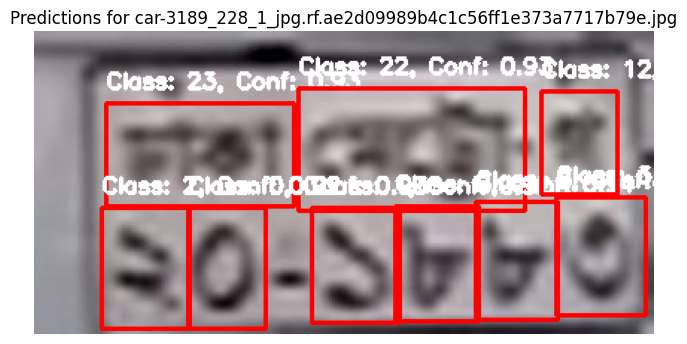


0: 288x640 1 0, 2 1s, 2 3s, 1 4, 1 ga, 1 metro, 1 dhaka, 142.3ms
Speed: 2.5ms preprocess, 142.3ms inference, 1.1ms postprocess per image at shape (1, 3, 288, 640)


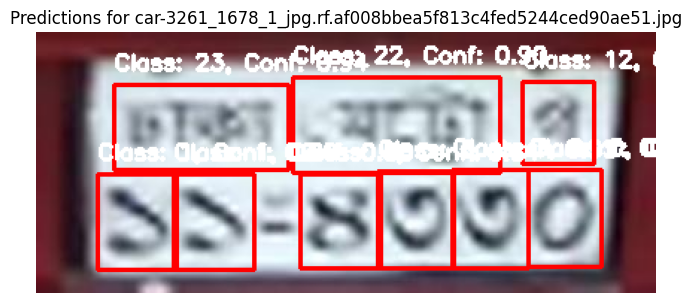


0: 288x640 2 0s, 2 1s, 1 7, 1 9, 1 ja, 1 metro, 1 khulna, 149.4ms
Speed: 2.3ms preprocess, 149.4ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


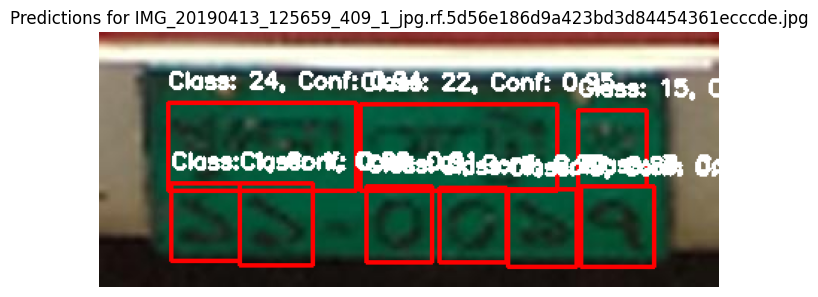


0: 352x640 1 1, 1 2, 1 3, 1 5, 1 6, 1 8, 1 ba, 1 metro, 1 dhaka, 189.2ms
Speed: 2.8ms preprocess, 189.2ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


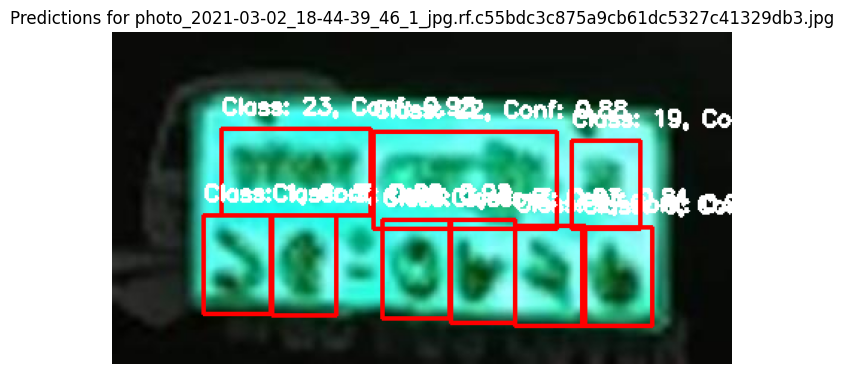


0: 576x640 2 1s, 1 4, 2 6s, 1 7, 1 ga, 1 metro, 1 dhaka, 244.6ms
Speed: 4.3ms preprocess, 244.6ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)


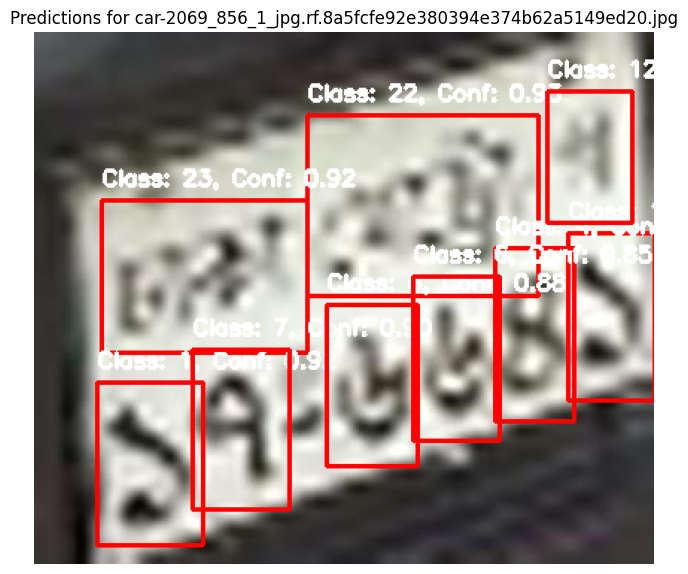


0: 384x640 1 0, 1 2, 2 5s, 1 7, 1 8, 1 ga, 1 metro, 1 dhaka, 187.5ms
Speed: 3.0ms preprocess, 187.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


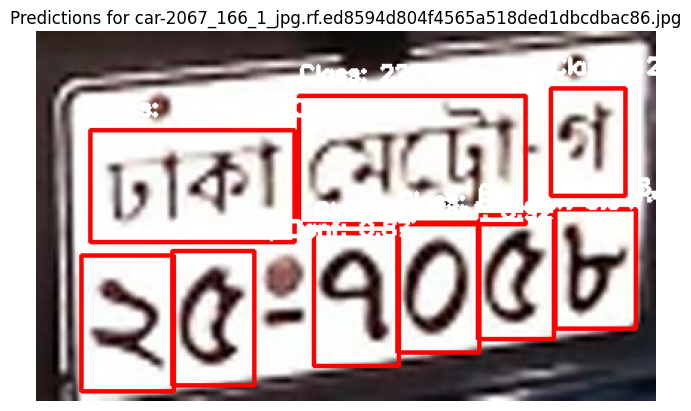


0: 384x640 1 0, 1 1, 1 4, 1 5, 1 7, 1 9, 1 ca, 1 metro, 1 dhaka, 203.3ms
Speed: 3.9ms preprocess, 203.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


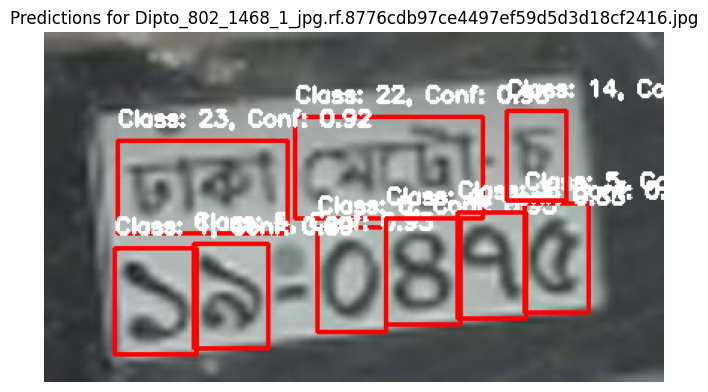


0: 384x640 2 0s, 2 1s, 1 2, 1 4, 1 ba, 1 metro, 1 khulna, 188.2ms
Speed: 3.2ms preprocess, 188.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


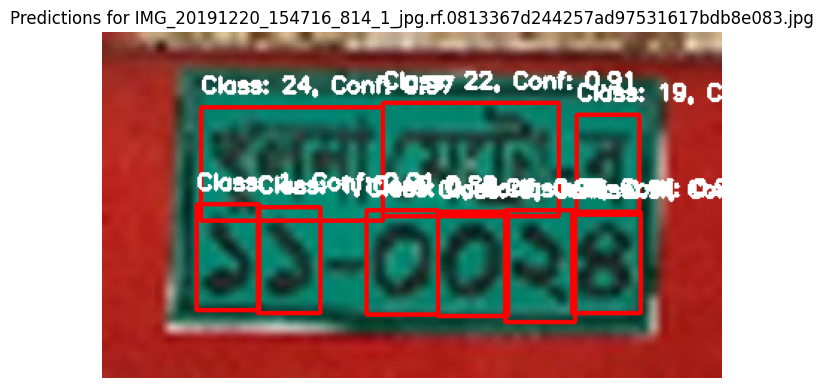


0: 352x640 1 1, 1 2, 2 3s, 1 4, 1 8, 1 kha, 1 metro, 1 dhaka, 174.5ms
Speed: 2.6ms preprocess, 174.5ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


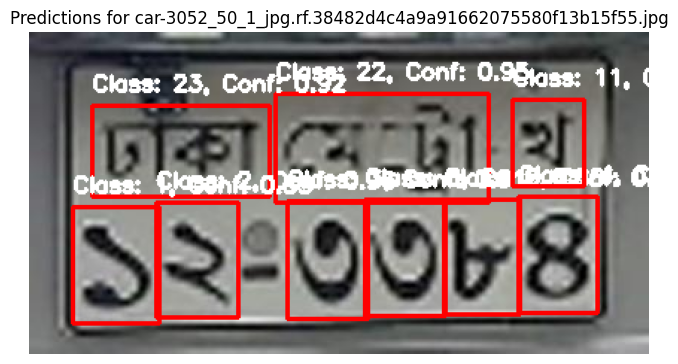


0: 448x640 4 0s, 1 1, 1 6, 1 ba, 1 metro, 1 khulna, 224.2ms
Speed: 3.4ms preprocess, 224.2ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


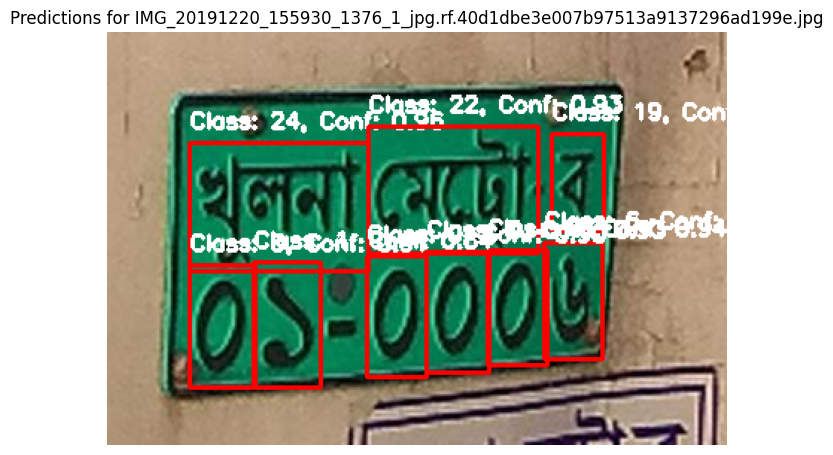


0: 352x640 1 0, 1 2, 1 6, 2 7s, 1 9, 1 ga, 1 metro, 1 dhaka, 183.6ms
Speed: 3.9ms preprocess, 183.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


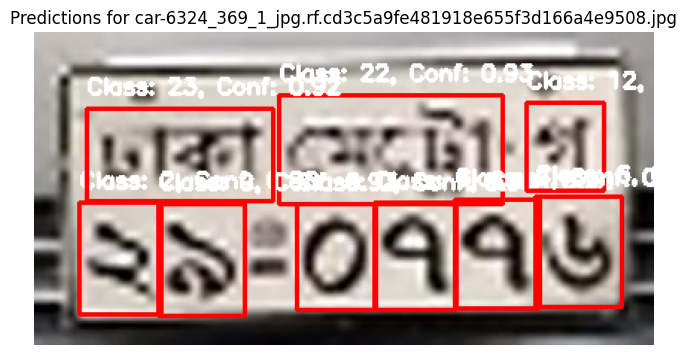


0: 288x640 1 1, 1 6, 1 7, 1 8, 2 9s, 1 ga, 1 metro, 1 dhaka, 143.5ms
Speed: 2.2ms preprocess, 143.5ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


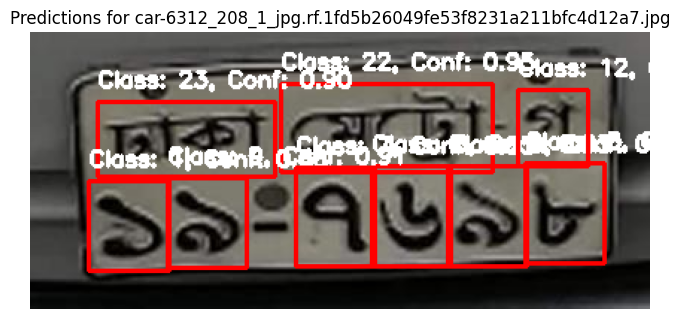


0: 448x640 1 0, 2 1s, 1 2, 2 9s, 1 ba, 1 jashore, 215.7ms
Speed: 3.4ms preprocess, 215.7ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)


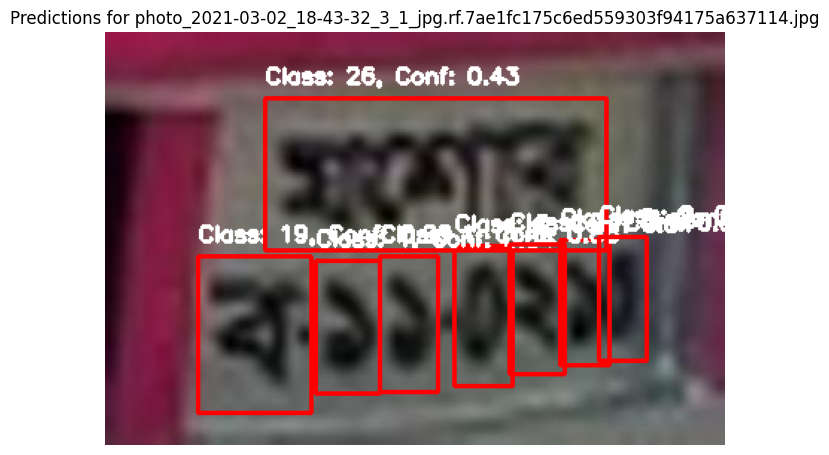


0: 320x640 1 0, 1 1, 2 2s, 1 5, 1 7, 1 ga, 1 metro, 1 dhaka, 173.5ms
Speed: 2.6ms preprocess, 173.5ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


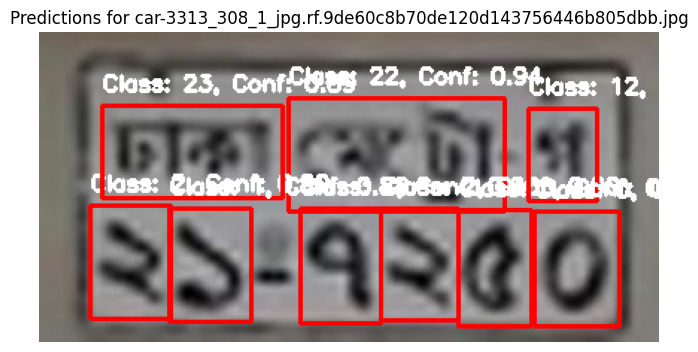


0: 320x640 1 1, 2 3s, 1 4, 1 5, 1 9, 1 ga, 1 metro, 1 dhaka, 175.1ms
Speed: 2.4ms preprocess, 175.1ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)


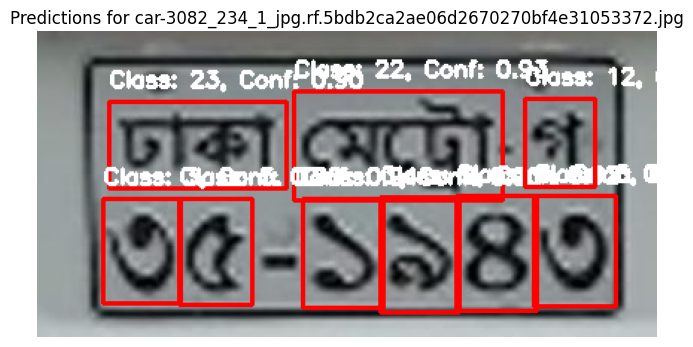


0: 352x640 1 0, 2 1s, 1 6, 2 7s, 1 ga, 1 metro, 1 dhaka, 168.6ms
Speed: 2.7ms preprocess, 168.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


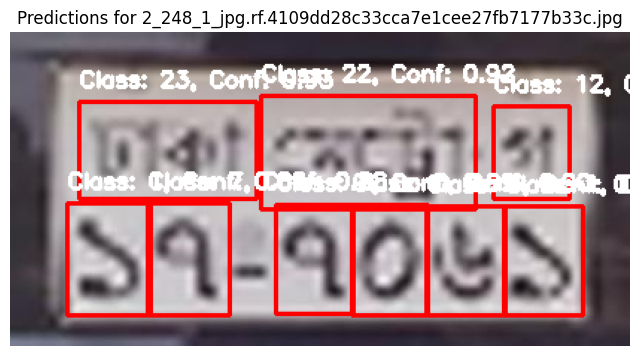


0: 320x640 3 0s, 2 1s, 1 4, 1 da, 1 jashore, 170.8ms
Speed: 2.5ms preprocess, 170.8ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)


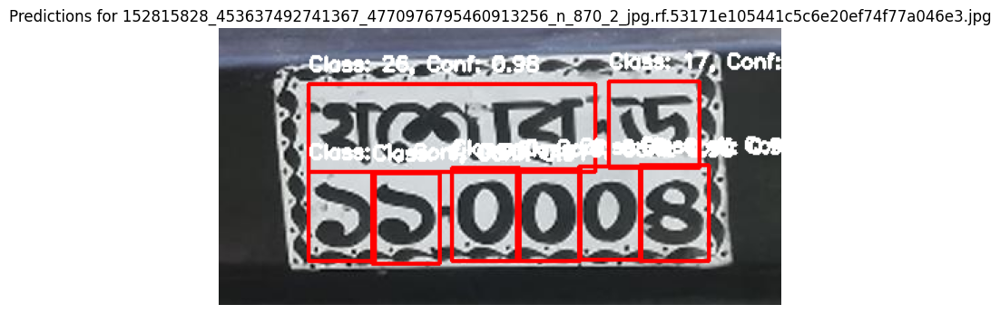


0: 384x640 2 1s, 2 3s, 1 4, 1 5, 1 ga, 1 metro, 1 dhaka, 183.4ms
Speed: 4.7ms preprocess, 183.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


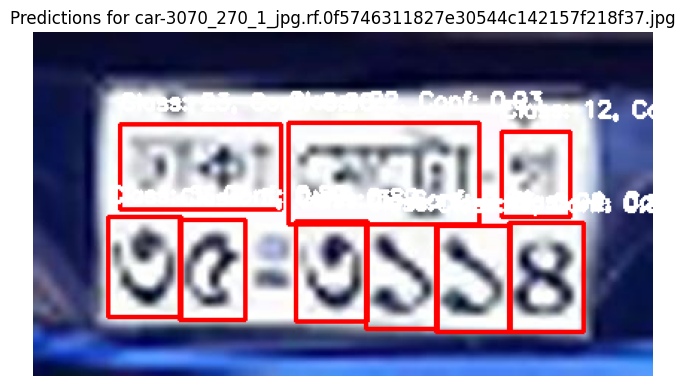


0: 320x640 1 1, 1 3, 3 4s, 1 6, 1 7, 1 9, 1 ta, 1 metro, 2 dhakas, 205.6ms
Speed: 2.5ms preprocess, 205.6ms inference, 1.3ms postprocess per image at shape (1, 3, 320, 640)


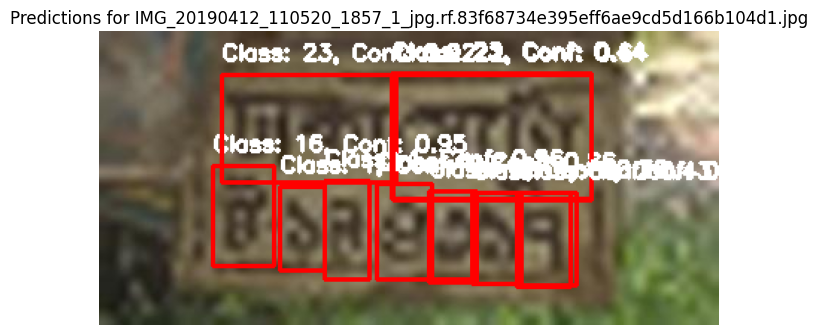


0: 448x640 1 0, 2 2s, 2 4s, 1 6, 1 ga, 1 metro, 1 dhaka, 274.8ms
Speed: 4.4ms preprocess, 274.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


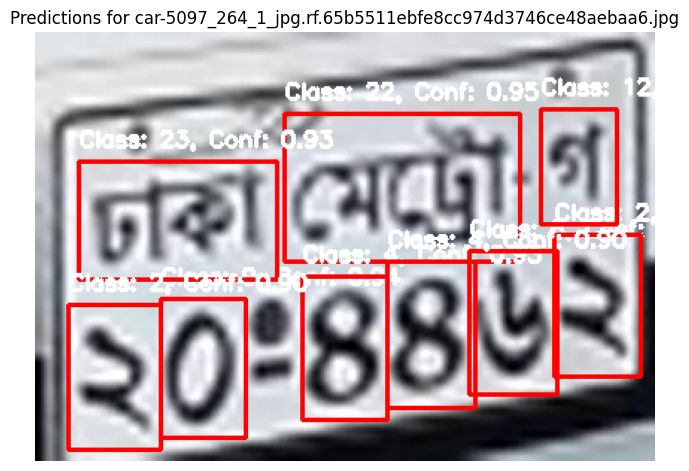


0: 352x640 1 0, 2 1s, 2 2s, 1 5, 1 ba, 1 metro, 1 dhaka, 197.7ms
Speed: 6.4ms preprocess, 197.7ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)


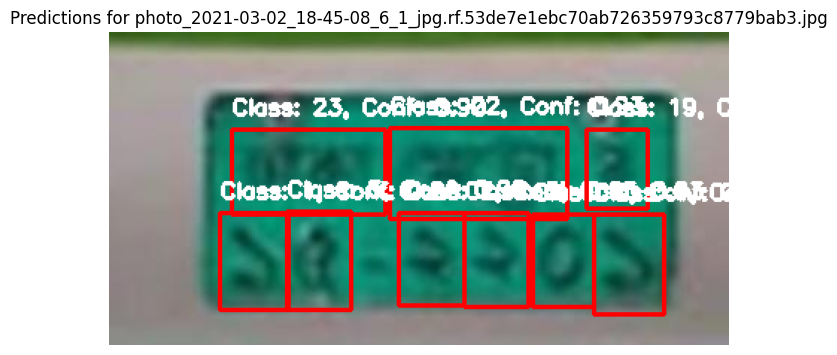


0: 416x640 1 0, 2 1s, 1 3, 1 7, 1 8, 1 gha, 1 metro, 1 dhaka, 260.8ms
Speed: 3.0ms preprocess, 260.8ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


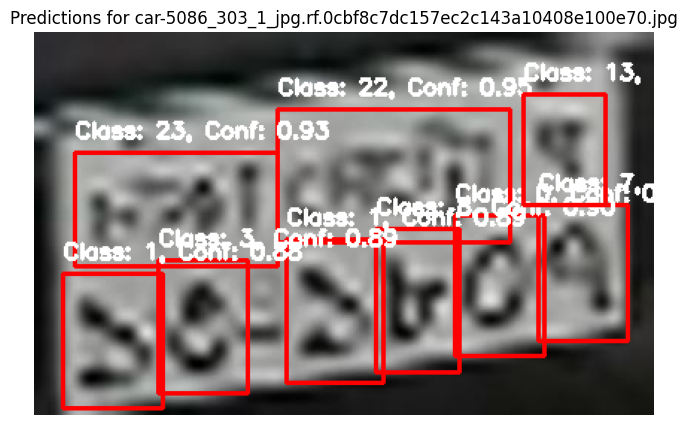


0: 384x640 1 2, 1 3, 2 4s, 1 7, 1 8, 1 ga, 1 metro, 1 dhaka, 222.0ms
Speed: 3.7ms preprocess, 222.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


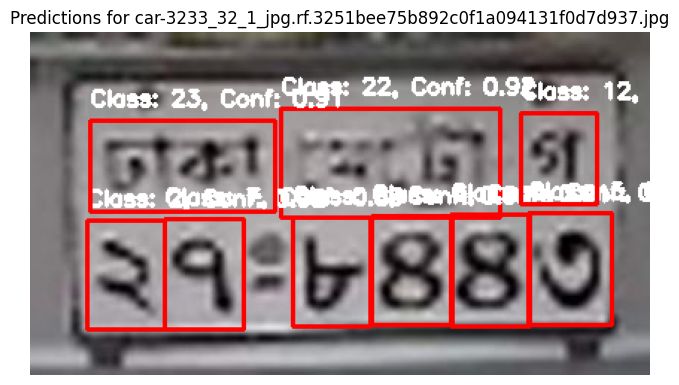


0: 288x640 1 0, 1 1, 1 2, 1 3, 1 4, 1 9, 1 ga, 1 metro, 1 dhaka, 200.5ms
Speed: 3.8ms preprocess, 200.5ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 640)


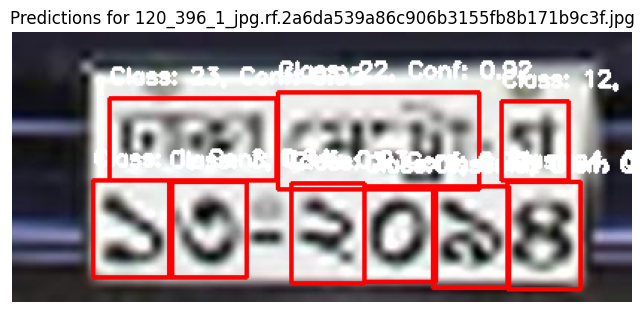


0: 352x640 1 1, 1 2, 1 4, 1 7, 1 8, 1 9, 1 na, 1 metro, 1 dhaka, 227.0ms
Speed: 5.6ms preprocess, 227.0ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)


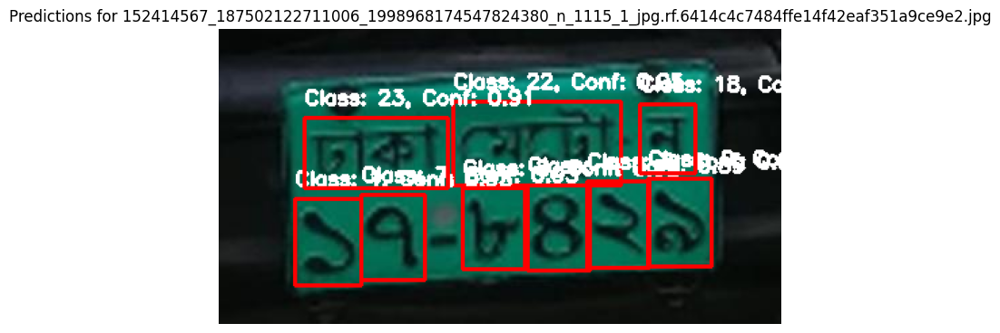


0: 320x640 2 1s, 1 3, 2 5s, 1 7, 1 ga, 1 metro, 1 chattogram, 195.5ms
Speed: 2.5ms preprocess, 195.5ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


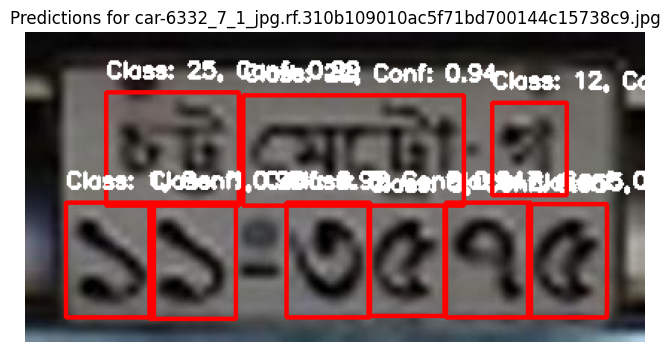


0: 320x640 1 0, 2 1s, 1 2, 1 3, 1 6, 1 metro, 1 dhaka, 170.6ms
Speed: 2.9ms preprocess, 170.6ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)


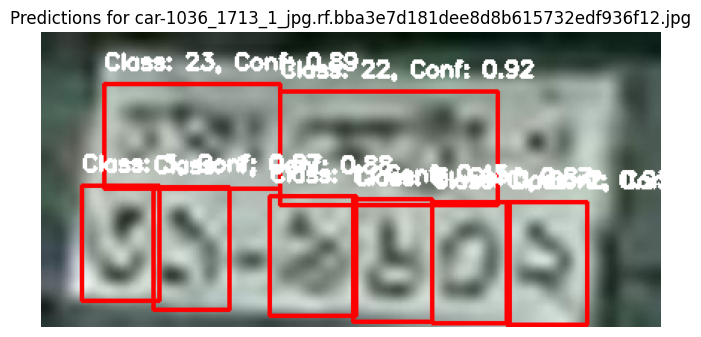


0: 288x640 1 1, 1 2, 2 5s, 1 8, 1 9, 1 metro, 1 dhaka, 164.7ms
Speed: 2.4ms preprocess, 164.7ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


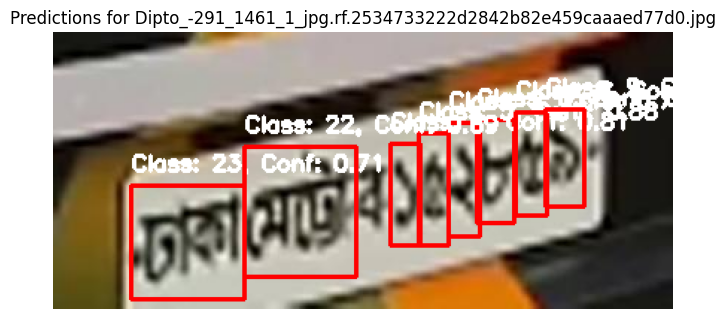


0: 352x640 1 0, 3 1s, 2 5s, 1 va, 1 metro, 1 dhaka, 205.6ms
Speed: 2.8ms preprocess, 205.6ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)


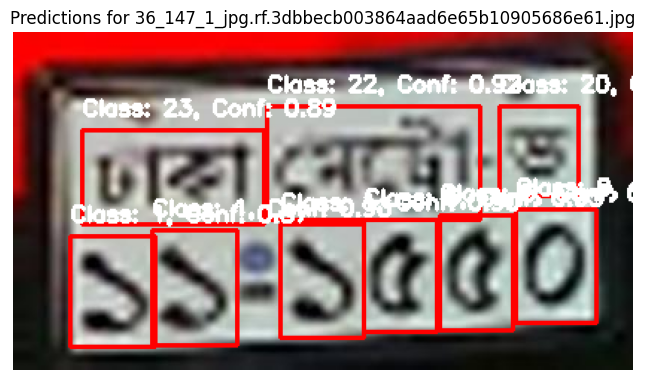


0: 352x640 1 0, 1 1, 2 2s, 2 8s, 1 ga, 1 metro, 1 dhaka, 176.5ms
Speed: 2.6ms preprocess, 176.5ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


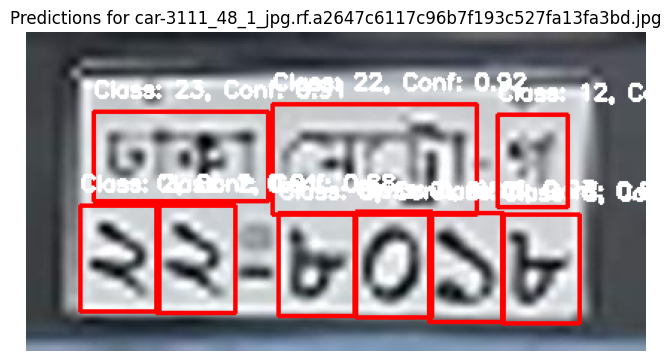


0: 352x640 1 0, 2 1s, 1 3, 1 8, 1 9, 1 metro, 1 dhaka, 162.7ms
Speed: 2.9ms preprocess, 162.7ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)


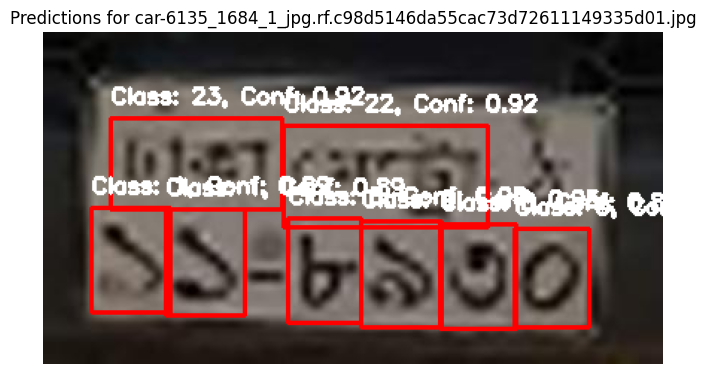


0: 352x640 2 0s, 1 1, 1 2, 1 7, 1 8, 1 ga, 1 metro, 1 dhaka, 195.8ms
Speed: 2.7ms preprocess, 195.8ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)


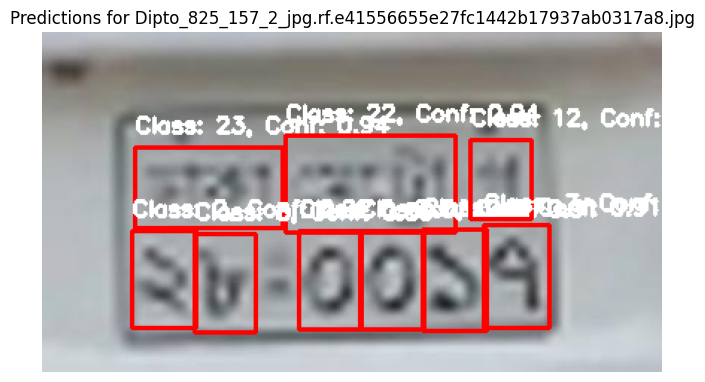


0: 288x640 1 1, 2 3s, 1 4, 1 7, 1 8, 1 ga, 1 metro, 1 dhaka, 132.5ms
Speed: 2.4ms preprocess, 132.5ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


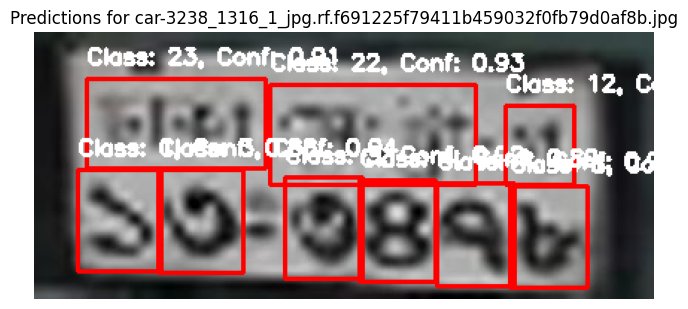


0: 480x640 1 0, 2 1s, 1 3, 1 4, 1 6, 1 9, 1 metro, 1 dhaka, 267.8ms
Speed: 3.5ms preprocess, 267.8ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


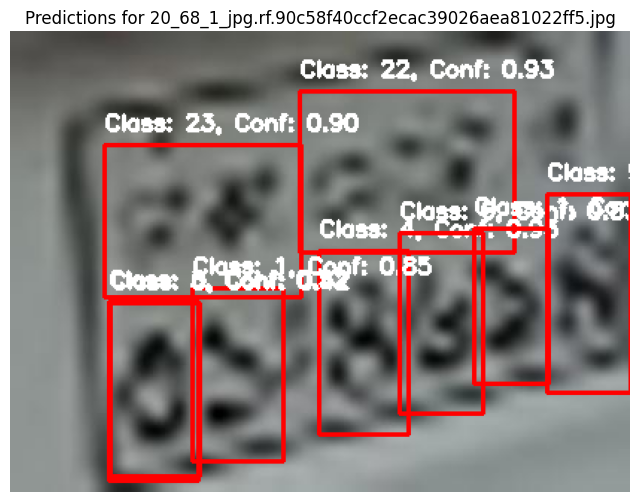


0: 416x640 3 0s, 1 4, 2 5s, 1 ja, 1 metro, 1 khulna, 196.0ms
Speed: 3.2ms preprocess, 196.0ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


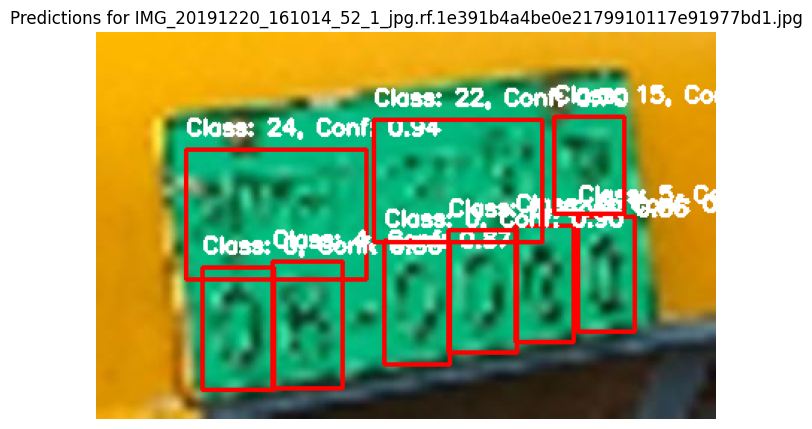


0: 480x640 1 1, 2 2s, 1 3, 2 4s, 1 ga, 1 metro, 1 dhaka, 257.2ms
Speed: 3.8ms preprocess, 257.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


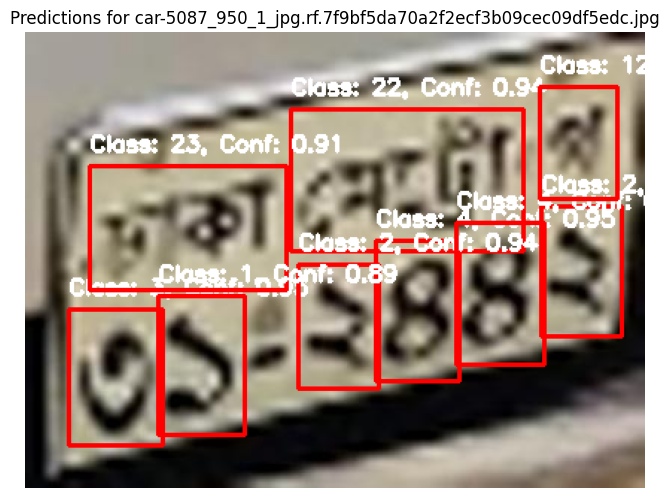


0: 640x640 2 0s, 1 2, 1 4, 1 8, 1 9, 1 ja, 1 metro, 1 dhaka, 347.2ms
Speed: 9.0ms preprocess, 347.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


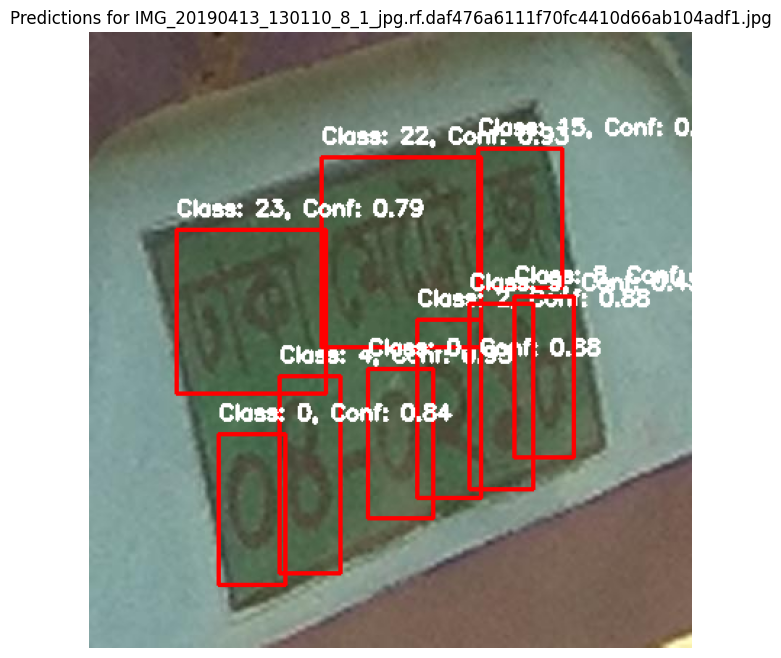


0: 608x640 1 1, 1 3, 2 4s, 1 8, 1 9, 1 ha, 1 jashore, 307.1ms
Speed: 8.5ms preprocess, 307.1ms inference, 2.4ms postprocess per image at shape (1, 3, 608, 640)


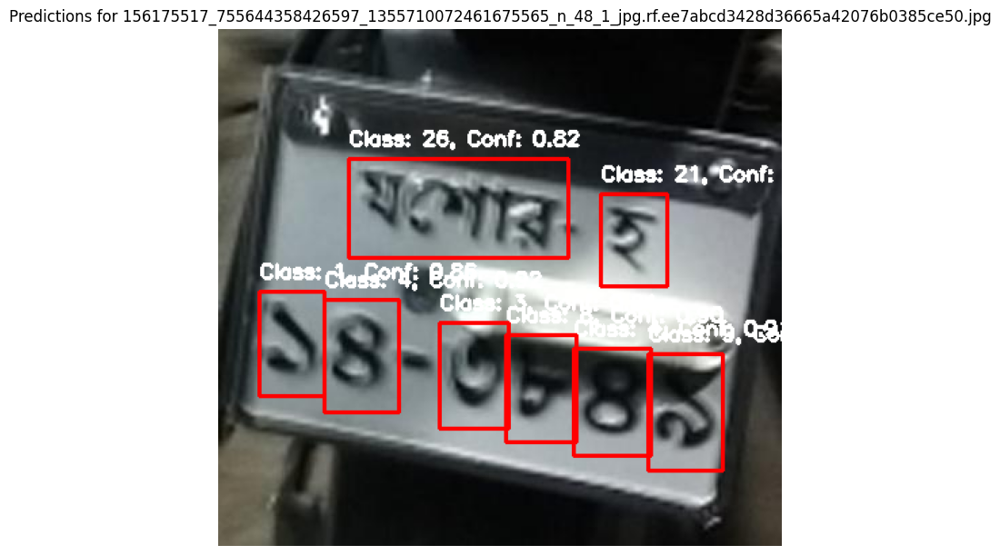


0: 416x640 2 0s, 1 2, 1 3, 1 6, 1 8, 1 ta, 1 jashore, 196.6ms
Speed: 5.4ms preprocess, 196.6ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


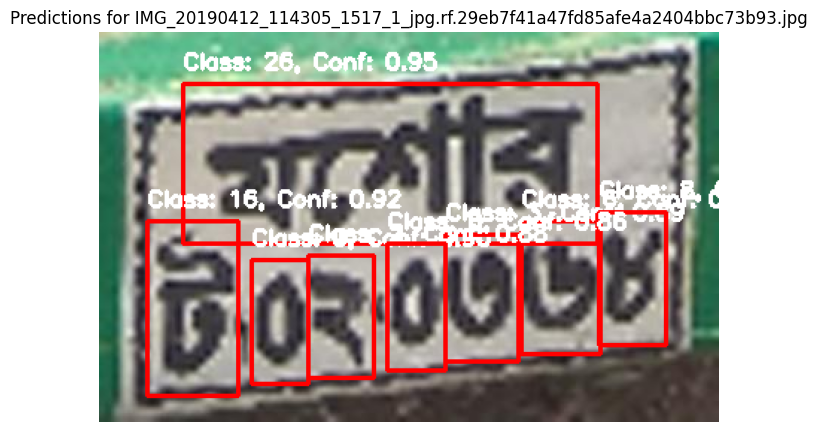


0: 320x640 1 0, 1 1, 1 3, 2 8s, 1 9, 1 gha, 1 metro, 1 dhaka, 167.4ms
Speed: 2.5ms preprocess, 167.4ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)


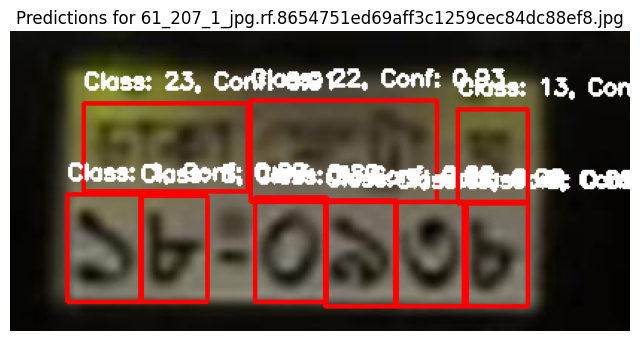


0: 352x640 1 3, 2 4s, 1 5, 1 8, 1 9, 1 gha, 1 metro, 1 dhaka, 180.9ms
Speed: 2.8ms preprocess, 180.9ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


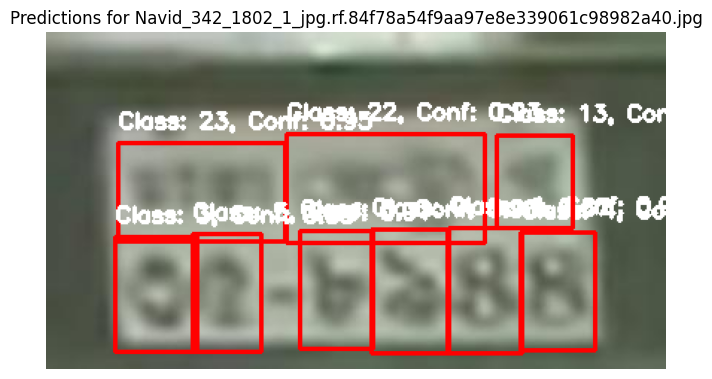


0: 288x640 2 2s, 1 3, 2 4s, 1 7, 1 ga, 1 metro, 1 dhaka, 139.0ms
Speed: 2.1ms preprocess, 139.0ms inference, 1.4ms postprocess per image at shape (1, 3, 288, 640)


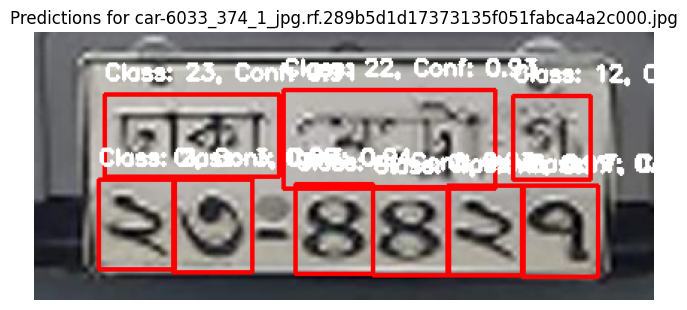


0: 512x640 1 0, 3 1s, 1 8, 1 9, 1 ta, 1 metro, 1 khulna, 245.0ms
Speed: 3.6ms preprocess, 245.0ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


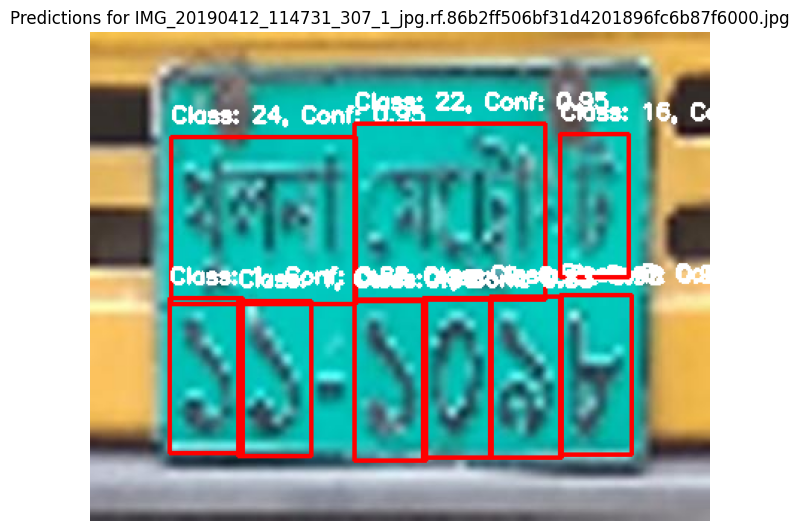


0: 352x640 1 1, 1 2, 2 4s, 1 6, 1 8, 1 ga, 1 metro, 1 dhaka, 188.3ms
Speed: 4.2ms preprocess, 188.3ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)


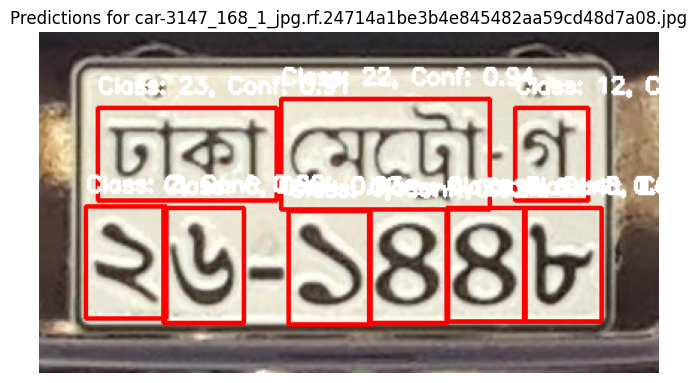


0: 352x640 1 0, 2 2s, 1 5, 1 6, 1 9, 1 ta, 1 metro, 1 dhaka, 183.3ms
Speed: 4.2ms preprocess, 183.3ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


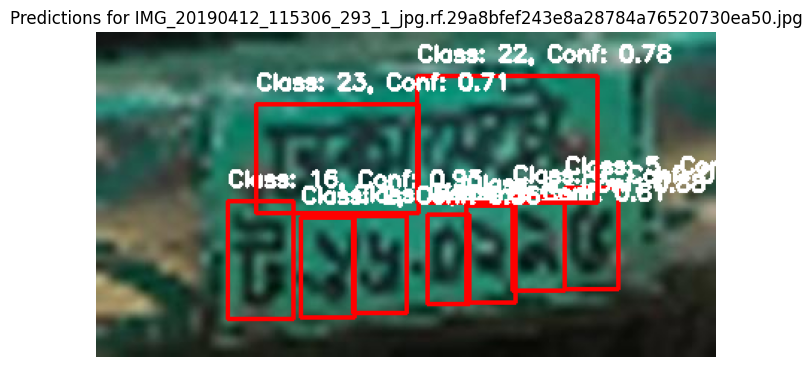


0: 352x640 1 1, 2 5s, 1 8, 2 9s, 1 ca, 1 metro, 1 dhaka, 169.3ms
Speed: 3.9ms preprocess, 169.3ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


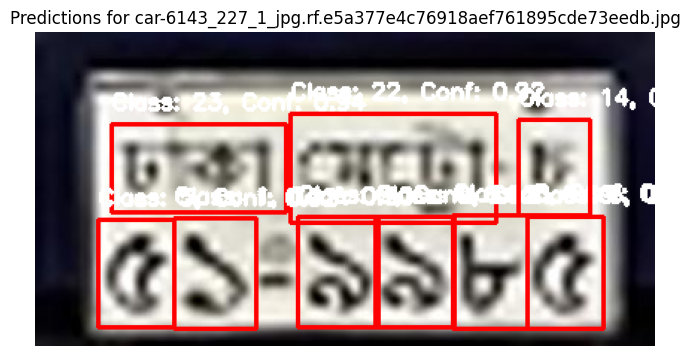


0: 352x640 2 0s, 1 2, 1 6, 1 8, 1 9, 1 va, 1 metro, 1 dhaka, 213.8ms
Speed: 4.2ms preprocess, 213.8ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


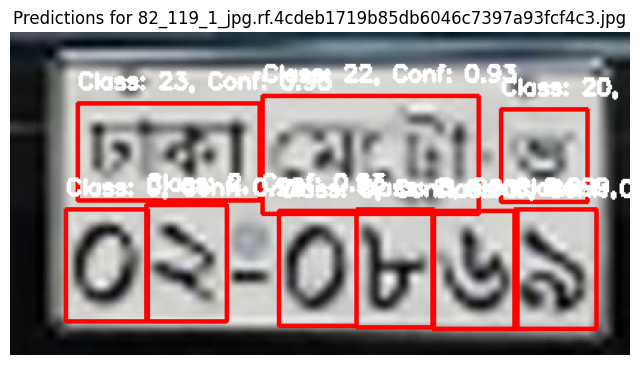


0: 320x640 3 1s, 2 4s, 1 7, 1 ga, 1 metro, 1 dhaka, 167.1ms
Speed: 2.5ms preprocess, 167.1ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 640)


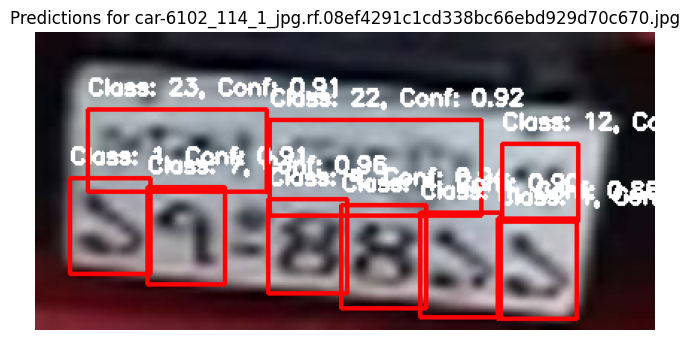


0: 320x640 1 1, 1 2, 1 3, 2 8s, 1 9, 1 ga, 1 metro, 1 dhaka, 181.5ms
Speed: 2.4ms preprocess, 181.5ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)


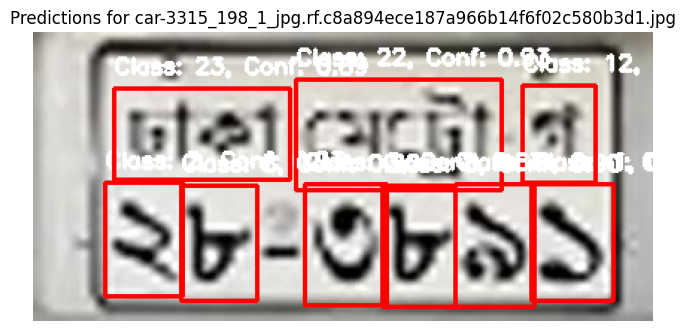


0: 352x640 1 0, 1 1, 1 2, 2 5s, 1 8, 1 ba, 1 metro, 1 dhaka, 173.5ms
Speed: 2.7ms preprocess, 173.5ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)


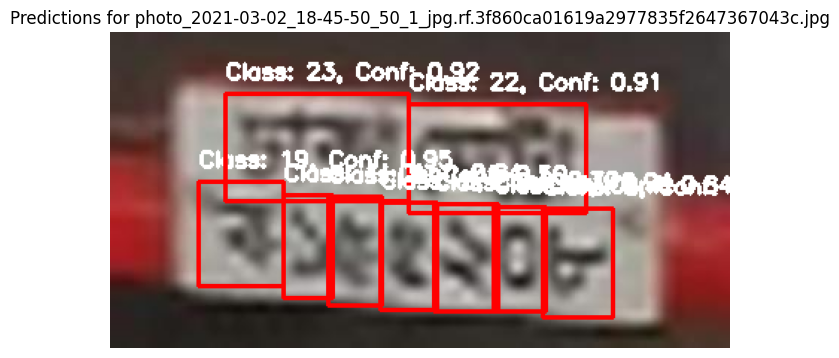


0: 352x640 2 0s, 1 1, 2 2s, 1 4, 1 ga, 1 metro, 1 dhaka, 229.7ms
Speed: 3.9ms preprocess, 229.7ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)


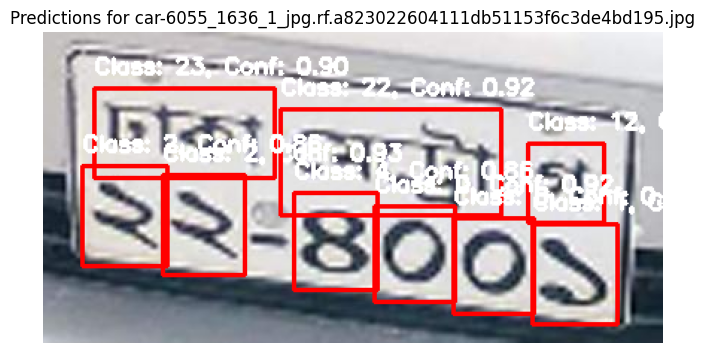


0: 544x640 2 0s, 2 1s, 1 6, 1 9, 1 ba, 1 metro, 1 khulna, 297.1ms
Speed: 4.0ms preprocess, 297.1ms inference, 2.3ms postprocess per image at shape (1, 3, 544, 640)


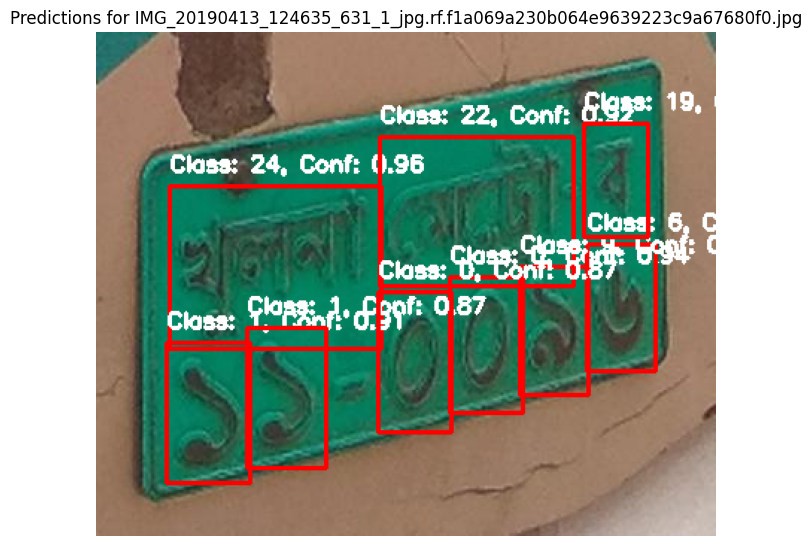


0: 352x640 1 0, 2 1s, 1 3, 1 7, 1 9, 1 ka, 1 metro, 1 chattogram, 196.1ms
Speed: 2.7ms preprocess, 196.1ms inference, 3.7ms postprocess per image at shape (1, 3, 352, 640)


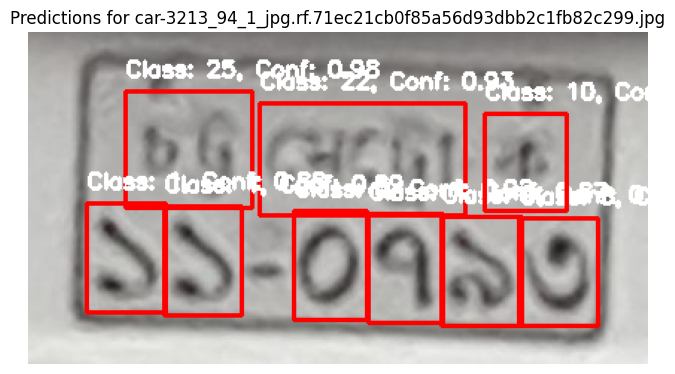


0: 576x640 1 1, 1 3, 3 5s, 1 9, 1 ga, 1 metro, 1 dhaka, 294.8ms
Speed: 9.1ms preprocess, 294.8ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)


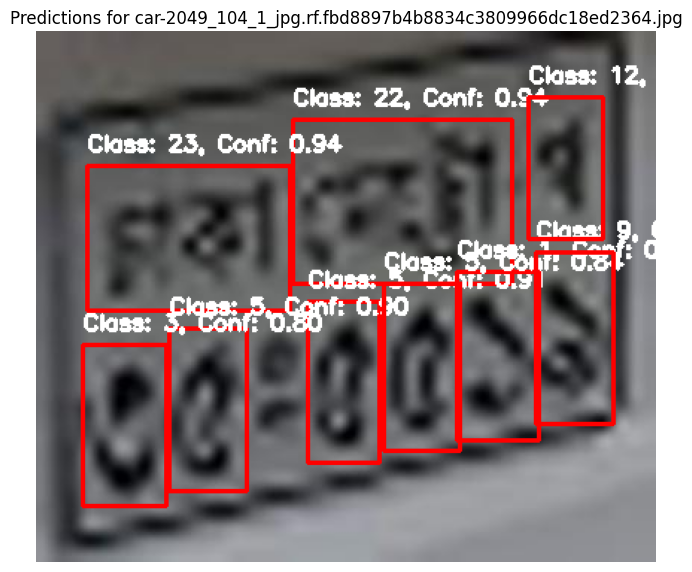


0: 352x640 2 1s, 1 3, 1 5, 2 9s, 1 ga, 1 metro, 1 dhaka, 180.1ms
Speed: 2.7ms preprocess, 180.1ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)


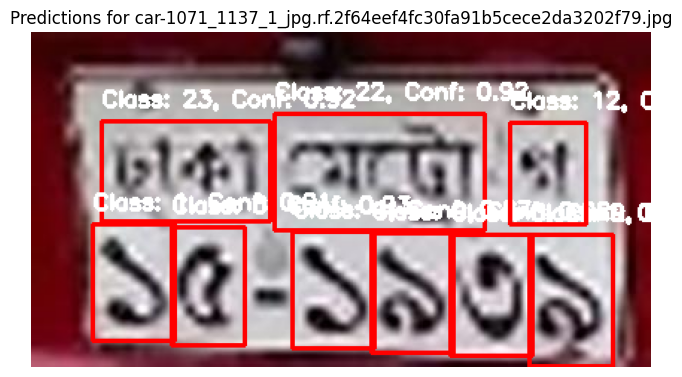


0: 352x640 1 1, 1 6, 1 7, 1 8, 2 9s, 1 ga, 1 metro, 1 dhaka, 196.2ms
Speed: 2.6ms preprocess, 196.2ms inference, 1.5ms postprocess per image at shape (1, 3, 352, 640)


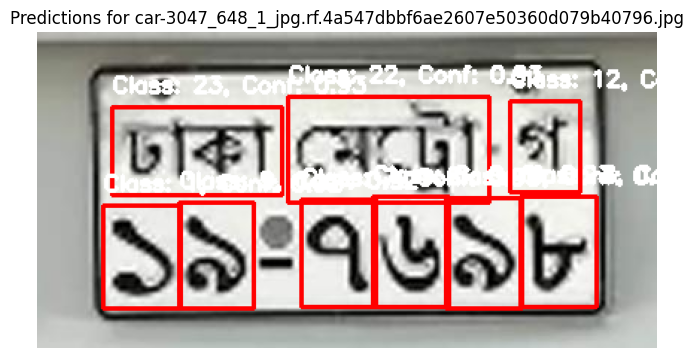


0: 640x640 2 0s, 2 1s, 1 6, 1 7, 1 ba, 1 metro, 1 khulna, 368.5ms
Speed: 4.6ms preprocess, 368.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


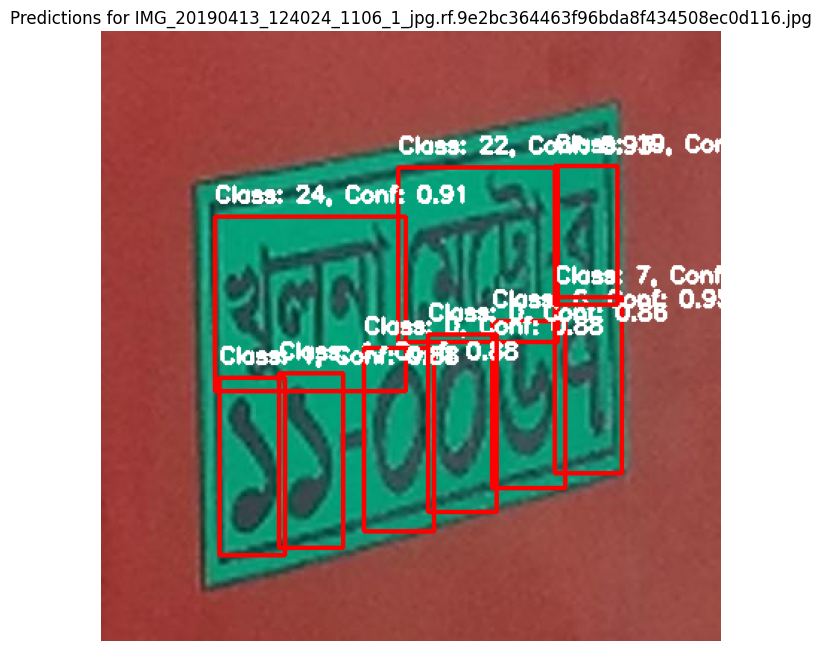


0: 448x640 1 1, 1 2, 2 3s, 2 9s, 1 ga, 1 metro, 1 dhaka, 250.2ms
Speed: 3.3ms preprocess, 250.2ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)


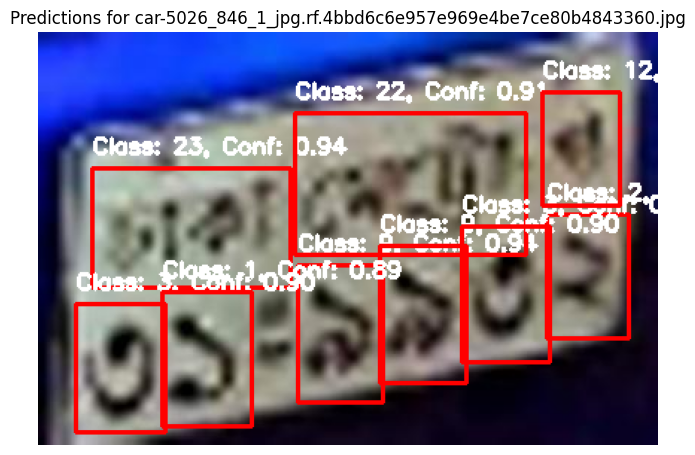


0: 320x640 3 1s, 2 2s, 1 6, 1 ga, 1 metro, 1 chattogram, 173.0ms
Speed: 2.6ms preprocess, 173.0ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 640)


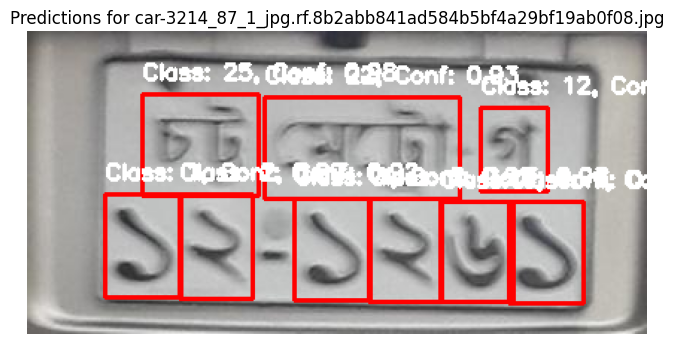


0: 352x640 2 1s, 1 2, 1 5, 1 8, 1 9, 1 gha, 1 metro, 1 dhaka, 204.0ms
Speed: 3.7ms preprocess, 204.0ms inference, 2.2ms postprocess per image at shape (1, 3, 352, 640)


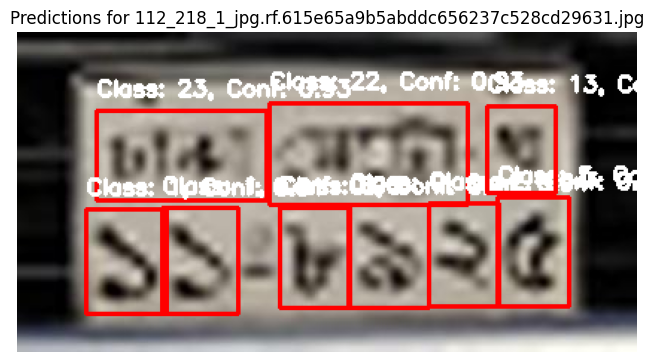


0: 352x640 1 2, 1 3, 1 4, 2 5s, 1 9, 1 ga, 1 metro, 1 dhaka, 214.0ms
Speed: 2.9ms preprocess, 214.0ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


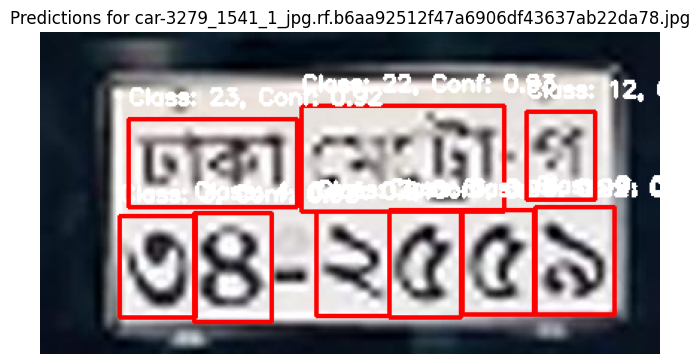


0: 416x640 1 0, 1 3, 1 5, 1 6, 1 8, 1 9, 1 ga, 1 metro, 1 dhaka, 197.8ms
Speed: 8.2ms preprocess, 197.8ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


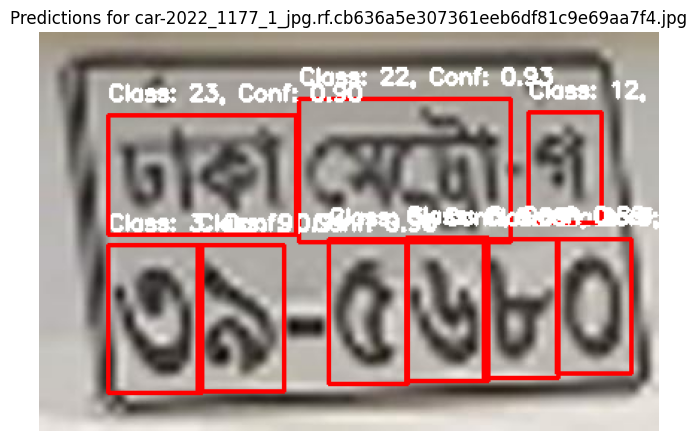


0: 480x640 1 1, 1 3, 1 4, 1 6, 2 7s, 1 ba, 1 metro, 1 dhaka, 227.2ms
Speed: 3.4ms preprocess, 227.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


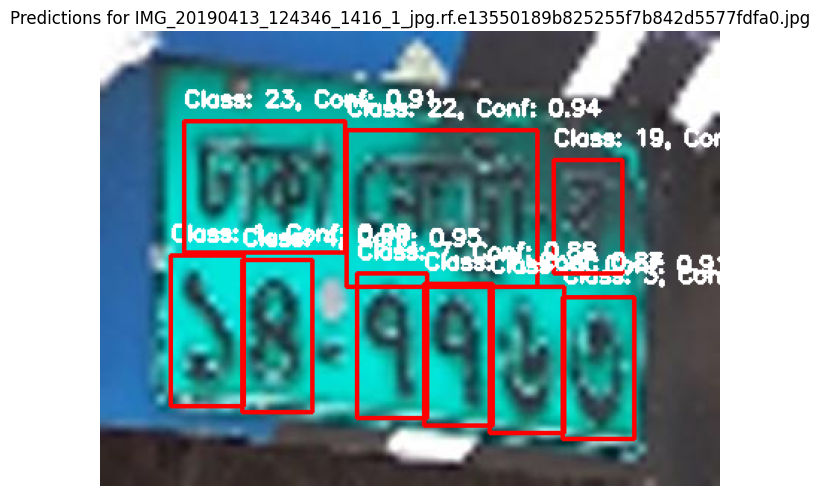


0: 352x640 1 0, 1 1, 2 3s, 1 6, 1 7, 1 metro, 1 dhaka, 163.4ms
Speed: 2.7ms preprocess, 163.4ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


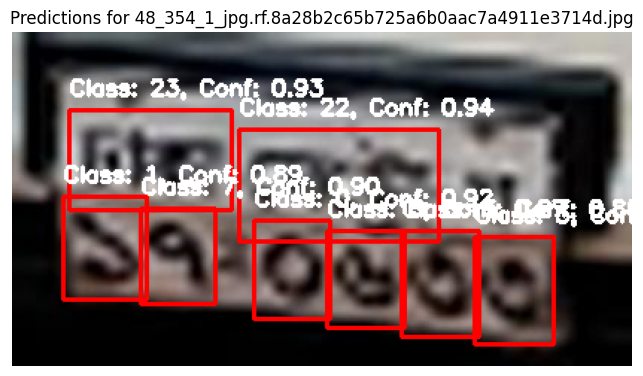


0: 320x640 2 0s, 1 1, 1 2, 1 3, 1 9, 1 kha, 1 metro, 1 dhaka, 162.3ms
Speed: 2.6ms preprocess, 162.3ms inference, 4.2ms postprocess per image at shape (1, 3, 320, 640)


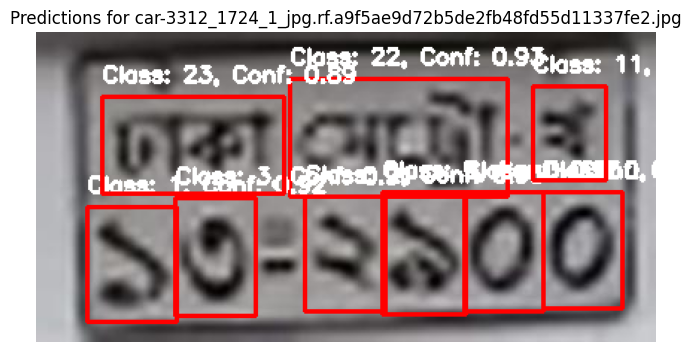


0: 512x640 3 1s, 1 2, 1 5, 1 9, 1 ja, 1 metro, 1 dhaka, 242.8ms
Speed: 3.8ms preprocess, 242.8ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)


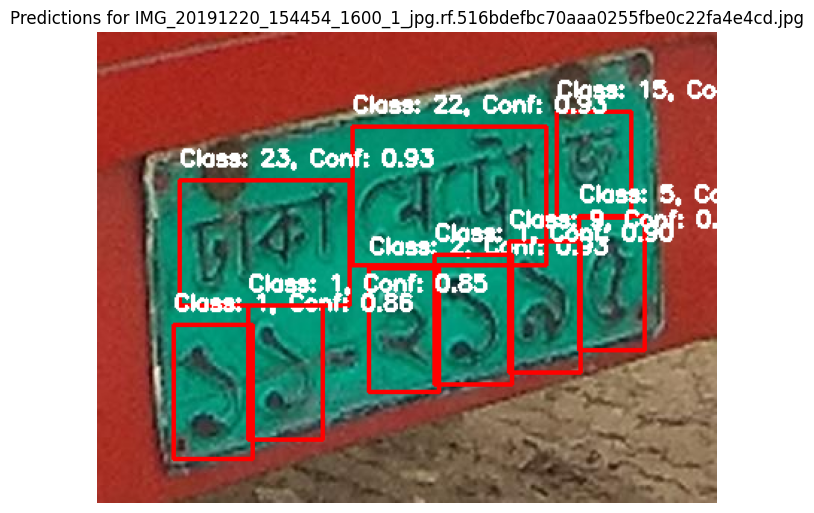


0: 448x640 1 0, 1 2, 1 3, 1 5, 1 8, 1 9, 1 ga, 1 metro, 1 dhaka, 232.9ms
Speed: 6.3ms preprocess, 232.9ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


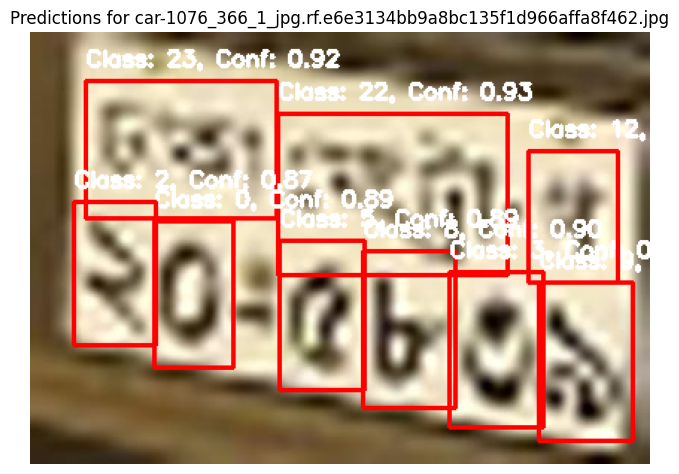


0: 352x640 2 0s, 1 3, 1 5, 1 7, 1 9, 1 ga, 1 metro, 1 dhaka, 178.0ms
Speed: 2.7ms preprocess, 178.0ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


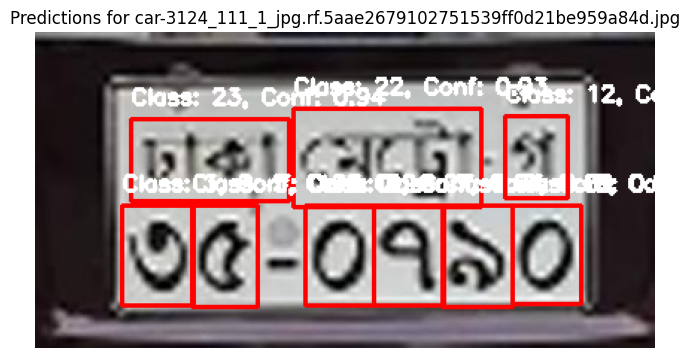


0: 352x640 1 1, 2 3s, 2 7s, 1 8, 1 ga, 1 metro, 1 dhaka, 182.4ms
Speed: 3.4ms preprocess, 182.4ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)


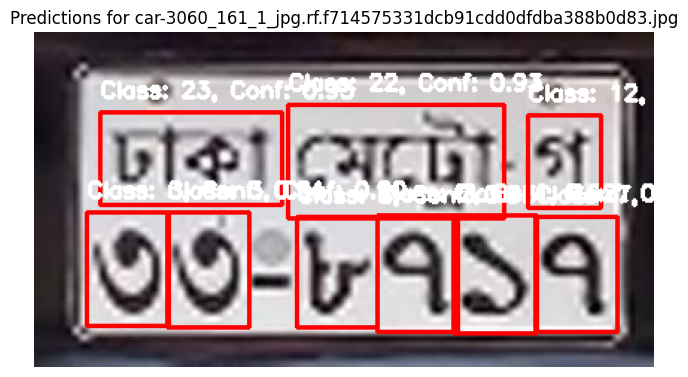


0: 512x640 1 0, 1 2, 4 8s, 1 ga, 1 metro, 1 dhaka, 247.7ms
Speed: 3.7ms preprocess, 247.7ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


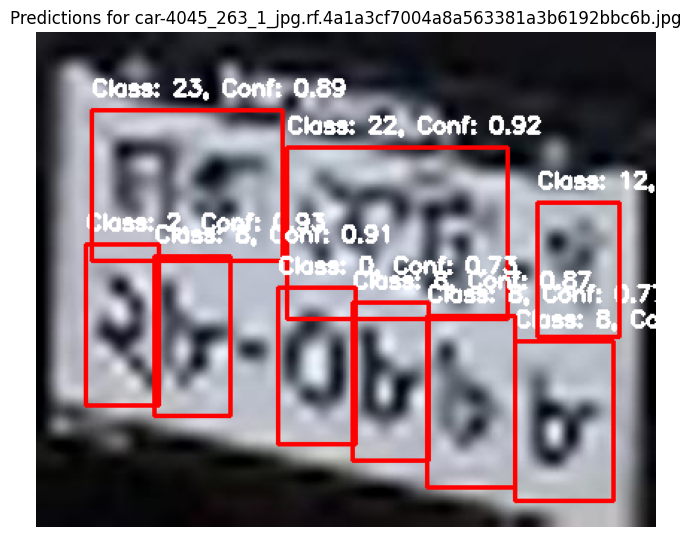


0: 640x640 4 1s, 1 2, 1 5, 1 ta, 1 metro, 1 khulna, 310.6ms
Speed: 6.4ms preprocess, 310.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


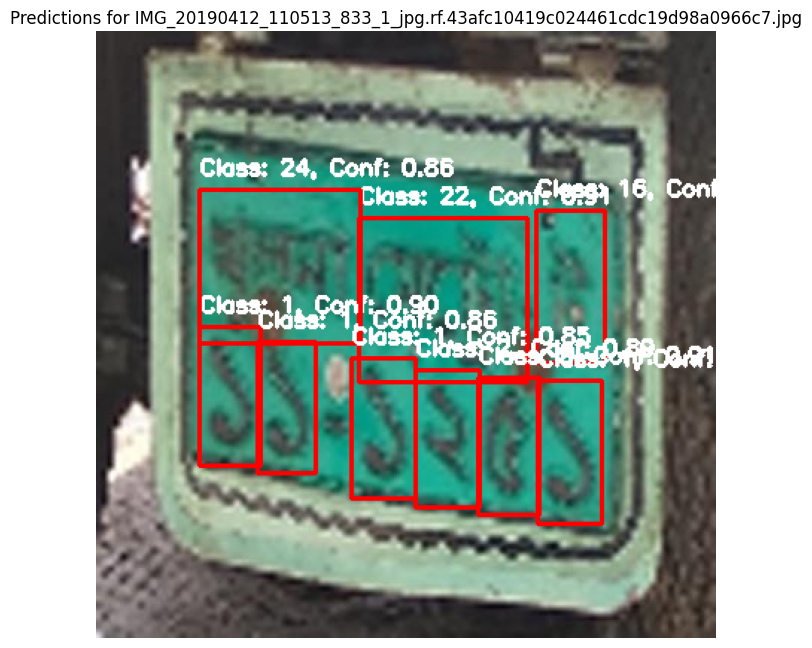


0: 320x640 1 1, 1 2, 1 5, 1 6, 1 7, 1 8, 1 gha, 1 metro, 1 dhaka, 175.8ms
Speed: 4.3ms preprocess, 175.8ms inference, 2.1ms postprocess per image at shape (1, 3, 320, 640)


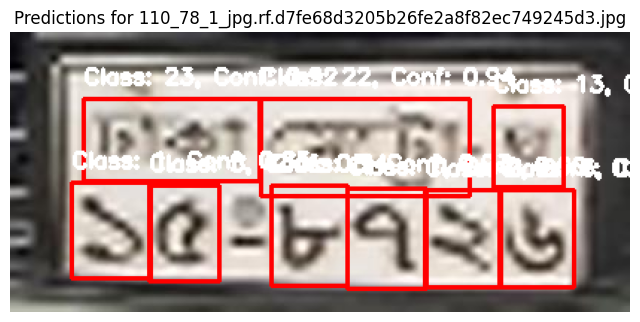


0: 384x640 2 1s, 2 3s, 1 5, 1 8, 1 ga, 1 metro, 1 chattogram, 180.8ms
Speed: 2.9ms preprocess, 180.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


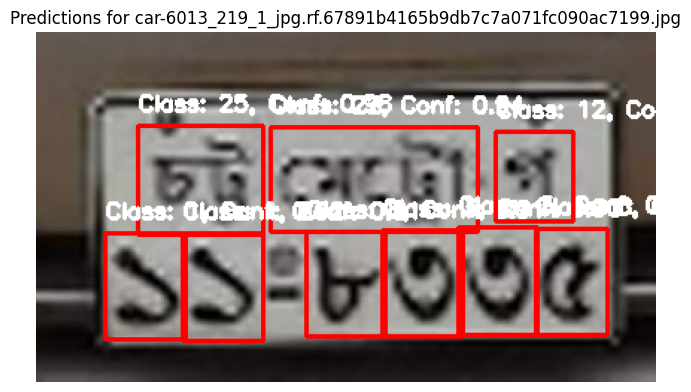


0: 416x640 1 0, 2 1s, 2 4s, 1 5, 1 gha, 1 metro, 1 dhaka, 223.0ms
Speed: 2.9ms preprocess, 223.0ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


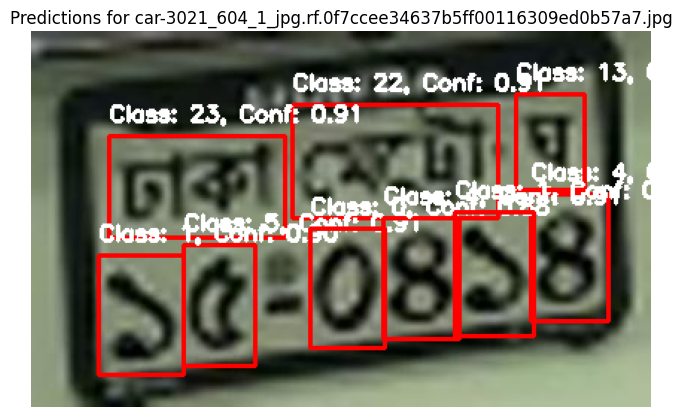


0: 384x640 1 0, 2 1s, 1 3, 1 5, 1 7, 1 ga, 1 metro, 1 dhaka, 182.4ms
Speed: 2.9ms preprocess, 182.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


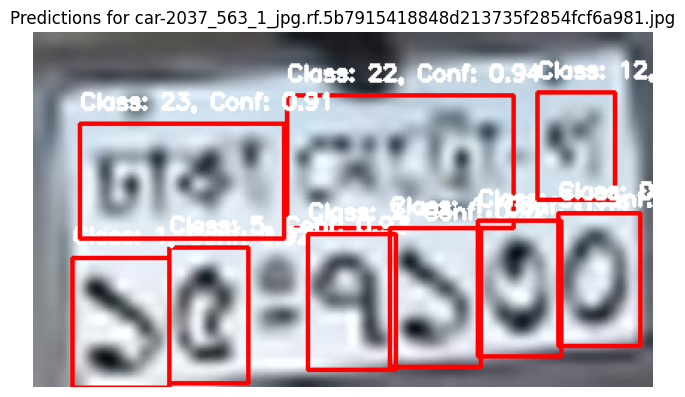


0: 320x640 1 1, 1 2, 1 3, 1 4, 1 5, 1 8, 1 ga, 1 metro, 1 dhaka, 180.0ms
Speed: 2.4ms preprocess, 180.0ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 640)


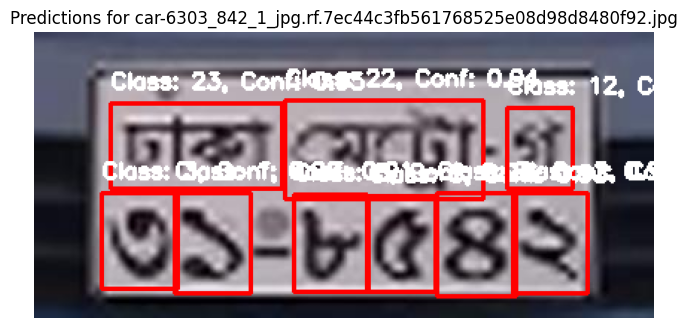


0: 352x640 1 0, 1 1, 1 5, 1 6, 1 7, 1 8, 1 gha, 1 metro, 1 dhaka, 162.1ms
Speed: 2.7ms preprocess, 162.1ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 640)


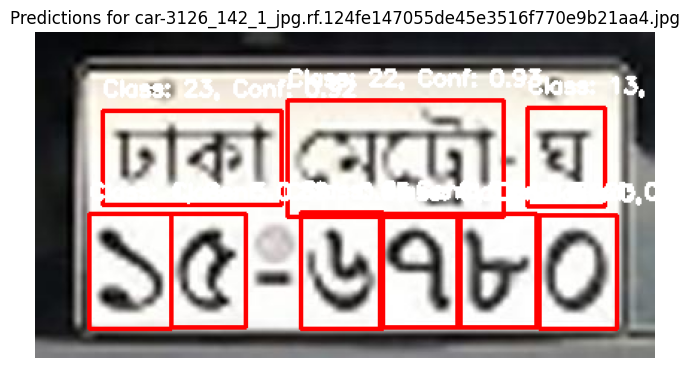


0: 320x640 2 1s, 1 2, 1 3, 1 4, 2 7s, 1 ba, 1 metro, 1 dhaka, 212.5ms
Speed: 2.5ms preprocess, 212.5ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)


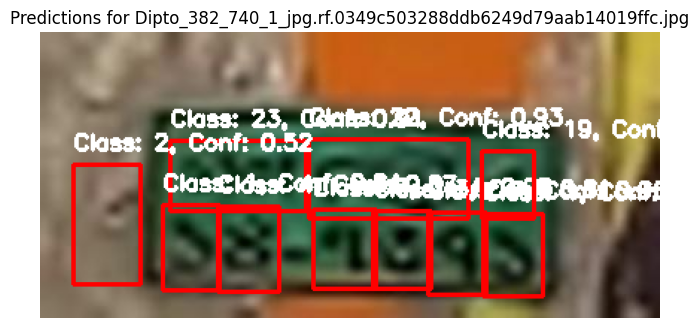


0: 288x640 1 1, 1 4, 1 5, 2 7s, 1 8, 1 ba, 1 metro, 1 dhaka, 162.5ms
Speed: 2.4ms preprocess, 162.5ms inference, 1.2ms postprocess per image at shape (1, 3, 288, 640)


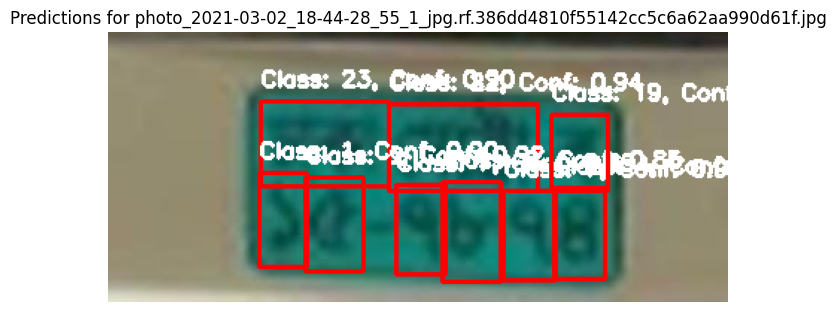


0: 224x640 3 2s, 1 6, 1 7, 1 8, 1 metro, 1 dhaka, 126.4ms
Speed: 1.8ms preprocess, 126.4ms inference, 3.2ms postprocess per image at shape (1, 3, 224, 640)


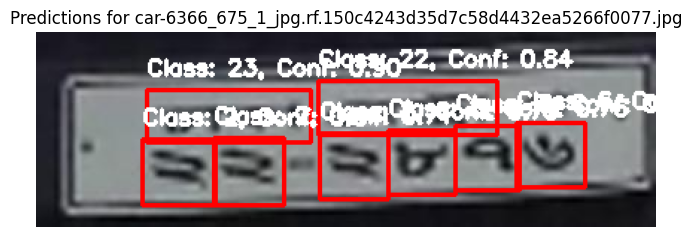


0: 352x640 1 0, 2 2s, 1 6, 1 8, 1 9, 1 kha, 1 metro, 1 dhaka, 170.9ms
Speed: 2.5ms preprocess, 170.9ms inference, 1.1ms postprocess per image at shape (1, 3, 352, 640)


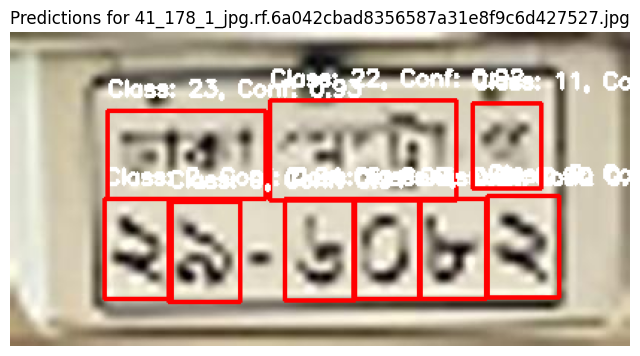

Predictions completed. Check the output folder for annotated images.


In [4]:
import os
import random
import cv2
import numpy as np
!pip install ultralytics
from ultralytics import YOLO # Import YOLO from ultralytics instead of Keras

import matplotlib.pyplot as plt



# Set folder path and model
folder_path = "/content/drive/MyDrive/Colab Notebooks/Character Recognition/test/images"  # Replace with your folder path
model_path = "/content/drive/MyDrive/Colab Notebooks/Character Recognition/runs/detect/train2/weights/best.pt"  # Replace with your model file
output_folder = "/content/predictions_output"  # Folder to save or display results

# Load your YOLOv8 model
model = YOLO(model_path)

# Ensure output folder exists
os.makedirs(output_folder, exist_ok=True)

# Get all image files from the folder
all_images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.lower().endswith(('png', 'jpg', 'jpeg'))]

# Randomly select 100 images
random_images = random.sample(all_images, min(len(all_images), 100))

# Function to preprocess an image
def preprocess_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img  # Ultralytics handles resizing internally

# Predict and display bounding boxes for each image
for img_path in random_images:
    # Preprocess image
    input_image = preprocess_image(img_path)

    # Predict using YOLO
    results = model.predict(source=input_image, save=False)  # save=False to avoid saving to disk
    predictions = results[0].boxes.data  # Access prediction data

    # Draw bounding boxes on the image
    for box in predictions:
        x1, y1, x2, y2, conf, cls = box.tolist()
        x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)

        # Draw rectangle and label
        cv2.rectangle(input_image, (x1, y1), (x2, y2), (255, 0, 0), 2)  # Blue box
        label = f"Class: {int(cls)}, Conf: {conf:.2f}"
        cv2.putText(input_image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    # Save the annotated image
    annotated_image_path = os.path.join(output_folder, f"annotated_{os.path.basename(img_path)}")
    cv2.imwrite(annotated_image_path, cv2.cvtColor(input_image, cv2.COLOR_RGB2BGR))

    # Display the image
    plt.figure(figsize=(8, 8))
    plt.imshow(input_image)
    plt.axis('off')
    plt.title(f"Predictions for {os.path.basename(img_path)}")
    plt.show()

print("Predictions completed. Check the output folder for annotated images.")



In [25]:
import shutil
import os

# Define source and destination directories
source_dir = "/content/runs"
dest_dir = "/content/drive/MyDrive/Colab Notebooks/Character Recognition/runs"  # Change destination to a new folder

# Create the destination directory if it doesn't exist
os.makedirs(dest_dir, exist_ok=True)

# Copy the contents of the source directory to the destination directory
for item in os.listdir(source_dir):
    s = os.path.join(source_dir, item)
    d = os.path.join(dest_dir, item)
    if os.path.isdir(s):
        shutil.copytree(s, d, dirs_exist_ok=True) # Use copytree for directories
    else:
        shutil.copy2(s, d) # Use copy2 for files

print(f"Files copied from '{source_dir}' to '{dest_dir}' successfully!")

Files copied from '/content/runs' to '/content/drive/MyDrive/Colab Notebooks/Character Recognition/runs' successfully!
